In [24]:
import pandas as pd
import yfinance as yf
import matplotlib.dates as mdates
import matplotlib.pyplot as plt
import numpy as np
from datetime import datetime
import statsmodels.api as sm
from scipy.signal import butter,filtfilt
from matplotlib import colors as mcolors
from sklearn.linear_model import LinearRegression
from random import sample
from tslearn.clustering import TimeSeriesKMeans
from tslearn.utils import to_time_series_dataset
from tslearn.shapelets import LearningShapelets
from collections import Counter

In [25]:
def preprocess(data):
    data=data['Adj Close']
    data=data.reset_index()
    data=data.rename(columns={ 'Date': 'date'})
    data_dict={}
    tics=[tic for tic in data.columns][1:]
    for tic in tics:
        temp=data.loc[:,['date',tic]]
        temp.rename(columns={tic:'adjcp'},inplace=True)
        temp=temp.assign(pct_return=temp['adjcp'].pct_change().fillna(0))
        data_dict[tic]=temp
    return data_dict,tics

In [39]:
def apply_to_all(tics,dataset,function):
    for tic in tics:
        function(dataset[tic])
def plot_ori(data,name):
    fig, ax = plt.subplots(1, 1, figsize=(20, 10),constrained_layout=True)
    if isinstance(data['date'][0],str):
        date=data['date'].apply(lambda x: datetime.strptime(x, '%Y-%m-%d'))
    else:
        date=data['date']
    ax.plot(date, data['adjcp'])
    ax.xaxis.set_major_locator(mdates.YearLocator(base=1))
    ax.xaxis.set_major_formatter(mdates.DateFormatter('%Y-%M'))
    ax.set_title(name+'_adjcp',fontsize=20)
    ax.grid(True)
def plot_pct(data,name):
    fig, ax = plt.subplots(1, 1, figsize=(20, 10),constrained_layout=True)
    if isinstance(data['date'][0],str):
        date=data['date'].apply(lambda x: datetime.strptime(x, '%Y-%m-%d'))
    else:
        date=data['date']
    ax.plot(date, data['pct_return'])
    ax.xaxis.set_major_locator(mdates.YearLocator(base=1))
    ax.xaxis.set_major_formatter(mdates.DateFormatter('%Y-%M'))
    ax.set_title(name+'pct_return',fontsize=20)
    ax.grid(True)
def plot_both(data,name):
    plot_ori(data,name)
    plot_pct(data,name)
    
    
def plot_filter(data,name,low=6, high=32, K=12):
    # see sm.tsa.filters.bkfilter for more detail, this method is not applied to the pipline for now
    filtered_data=sm.tsa.filters.bkfilter(data[['adjcp','pct_return']],low,high,K)
    if isinstance(data['date'][0],str):
        date=data['date'][K:-K].apply(lambda x: datetime.strptime(x, '%Y-%m-%d'))
    else:
        date=data['date'][K:-K]
    fig, ax = plt.subplots(2, 1, figsize=(20, 10),constrained_layout=True)
    ax[0].plot(date,filtered_data['adjcp_cycle'],label='adjcp_cycle')
    ax[1].plot(date,filtered_data['pct_return_cycle'],label='pct_return_cycle')
    ax[0].xaxis.set_major_locator(mdates.YearLocator(base=1))
    ax[0].xaxis.set_major_formatter(mdates.DateFormatter('%Y-%M'))
    ax[1].xaxis.set_major_locator(mdates.YearLocator(base=1))
    ax[1].xaxis.set_major_formatter(mdates.DateFormatter('%Y-%M'))
    ax[0].set_title(name+'_adjcp_cycle',fontsize=20)
    ax[1].set_title(name+'_pct_return_cycle',fontsize=20)
    ax[0].grid(True)
    ax[1].grid(True)
def butter_lowpass_filter(data, Wn, order):
    # suppose the data is sample at 7Hz (7days / week) so fs=7 and fn=7/2, we would like to eliminate volatility on weekly scale, then we should have
    # Wn=1/(7/2)=2/7 
    b, a = butter(order, Wn, btype='low', analog=False)
    y = filtfilt(b, a, data)
    return y
def adjcp_apply_filter(data,Wn_adjcp,Wn_pct,order):
    data['adjcp_filtered']=butter_lowpass_filter(data['adjcp'], Wn_adjcp, order)
    data['pct_return_filtered']=butter_lowpass_filter(data['pct_return'], Wn_pct, order)
def plot_by_suffix(data,name,data_suffix,savefig):
    fig, ax = plt.subplots(2, 1, figsize=(20, 10),constrained_layout=True)
    if isinstance(data['date'][0],str):
        date=data['date'].apply(lambda x: datetime.strptime(x, '%Y-%m-%d'))
    else:
        date=data['date']
    ax[0].plot(date, data['adjcp'+data_suffix])
    ax[0].xaxis.set_major_locator(mdates.YearLocator(base=1))
    ax[0].xaxis.set_major_formatter(mdates.DateFormatter('%Y-%M'))
    ax[0].set_title(name+'_adjcp'+data_suffix,fontsize=20)
    ax[1].plot(date, data['pct_return'+data_suffix])
    ax[1].xaxis.set_major_locator(mdates.YearLocator(base=1))
    ax[1].xaxis.set_major_formatter(mdates.DateFormatter('%Y-%M'))
    ax[1].set_title(name+'_pct_return'+data_suffix,fontsize=20)
    if savefig:
        fig.savefig('res/'+name+data_suffix+'.png')
def find_index_of_turning(data):
    turning_points=[0]
    data=data.reset_index(drop=True)
    for i in range(data['pct_return_filtered'].size-1):
        if data['pct_return_filtered'][i]*data['pct_return_filtered'][i+1]<0:
            turning_points.append(i+1)
    if turning_points[-1]!=data['pct_return_filtered'].size:
        turning_points.append(data['pct_return_filtered'].size)
    return turning_points

def linear_regession_turning_points(data_ori,tic):
    data=data_ori.reset_index(drop=True)
    turning_points=find_index_of_turning(data)
    coef_list=[]
    normalized_coef_list=[]
    y_pred_list=[]
    for i in range(len(turning_points)-1):
        x_seg=np.asarray([j for j in range(turning_points[i],turning_points[i+1])]).reshape(-1, 1)
#         print(x_seg,data['adjcp_filtered'].iloc[turning_points[i]:turning_points[i+1]])
        adj_cp_model = LinearRegression().fit(x_seg,data['adjcp_filtered'].iloc[turning_points[i]:turning_points[i+1]])
        y_pred = adj_cp_model.predict(x_seg)
        normalized_coef_list.append(100*adj_cp_model.coef_/data['adjcp_filtered'].iloc[turning_points[i]])
        coef_list.append(adj_cp_model.coef_)
        y_pred_list.append(y_pred)
    return np.asarray(coef_list),np.asarray(turning_points),y_pred_list,normalized_coef_list


def linear_regession_label(data,y_pred_list,turning_points,low,high,normalized_coef_list,cluster_metric,tic):
    data=data.reset_index(drop=True)[cluster_metric]
    data_seg=[]
    seg1,seg2,seg3=sorted([low,high,0])
    label=[]
    label_seg=[]
    index_seg=[]
    for i in range(len(turning_points)-1):
        x_seg=np.asarray([j for j in range(turning_points[i],turning_points[i+1])]).reshape(-1, 1)
        coef=normalized_coef_list[i]
        if coef<=seg1:
            flag=0
        elif coef>seg1 and coef<=seg2:
            flag=1
        elif coef>seg2 and coef<=seg3:
            flag=2
        elif coef>seg3:
            flag=3
        label.extend([flag]*(turning_points[i+1]-turning_points[i]))
        if turning_points[i+1]-turning_points[i]>1:
            data_seg.append(data.iloc[turning_points[i]:turning_points[i+1]].to_list())
            label_seg.append(flag)
            index_seg.append(tic+'_'+str(i))
    return label,data_seg,label_seg,index_seg 


def linear_regession_plot(data,tic,y_pred_list,turning_points,low,high,savefig,normalized_coef_list):
    data=data.reset_index(drop=True)
    fig, ax = plt.subplots(2, 1, figsize=(20, 10),constrained_layout=True)
    ax[0].plot([i for i in range(data.shape[0])], data['adjcp_filtered'])
    seg1,seg2,seg3=sorted([low,high,0])
    colors = list(dict(mcolors.BASE_COLORS, **mcolors.CSS4_COLORS).keys())
    for i in range(len(turning_points)-1):
        x_seg=np.asarray([j for j in range(turning_points[i],turning_points[i+1])]).reshape(-1, 1)
        y_pred = y_pred_list[i]
        coef=normalized_coef_list[i]
        if coef<=seg1:
            flag=0
        elif coef>seg1 and coef<=seg2:
            flag=1
        elif coef>seg2 and coef<=seg3:
            flag=2
        elif coef>seg3:
            flag=3
        ax[1].plot(x_seg,y_pred,color=colors[flag], label='cat'+str(flag))
    handles, labels = plt.gca().get_legend_handles_labels()
    by_label = dict(zip(labels, handles))
    plt.legend(by_label.values(), by_label.keys())
    ax[0].set_title(tic+'_linear_regression_regime',fontsize=20)
    if savefig:
        fig.savefig('res/linear_model/'+tic+'.png')
        
def linear_regession_timewindow(data_ori,tic,adjcp_timewindow):
    data=data_ori.iloc[:adjcp_timewindow*(data_ori['adjcp_filtered'].size//adjcp_timewindow),:]
    adjcp_window_data=[data[['adjcp_filtered']][i*adjcp_timewindow:(i+1)*adjcp_timewindow].to_numpy().reshape(-1) for i in range(data['adjcp_filtered'].size//adjcp_timewindow)]
    coef_list=[]
    fig, ax = plt.subplots(2, 1, figsize=(20, 10),constrained_layout=True)
    ax[0].plot([i for i in range(data.shape[0])], data['adjcp_filtered'])
    for i,data_seg in enumerate(adjcp_window_data):
        x_seg=np.asarray([i*adjcp_timewindow+j for j in range(adjcp_timewindow)]).reshape(-1, 1)
        adj_cp_model = LinearRegression().fit(x_seg,data_seg)
        y_pred = adj_cp_model.predict(x_seg)
        ax[1].plot([i*adjcp_timewindow+j for j in range(adjcp_timewindow)],y_pred)
        coef_list.append(adj_cp_model.coef_)
    return coef_list
def validation_plot(data,tic,cluster_metic,turning_point,savefig,seg_list,label_list,color_list):
    data=data.reset_index(drop=True)[cluster_metic]
    fig, ax = plt.subplots(1, 1, figsize=(20, 10),constrained_layout=True)
    colors = list(dict(mcolors.BASE_COLORS, **mcolors.CSS4_COLORS).keys())
    for i in range(len(turning_points)-1):
        x_seg=np.asarray([j for j in range(turning_points[i],turning_points[i+1])]).reshape(-1, 1)
        y=data.iloc[turning_points[i]:turning_points[i+1]]
        if turning_points[i+1]-turning_points[i]<=1 or tic+'_'+str(i) not in seg_list :
            continue
        flag=label_list[seg_list.index(tic+'_'+str(i))]
        if color_list[flag]:
            c=color_list[flag]
        else:
            c=flag+len(color_list)
        ax.plot(x_seg,y,color=colors[c], label='cluster'+str(flag))
    handles, labels = plt.gca().get_legend_handles_labels()
    by_label = dict(zip(labels, handles))
    plt.legend(by_label.values(), by_label.keys())
    ax.set_title(tic+'_linear_regression_crossvalidation',fontsize=20)
    if savefig:
        fig.savefig('res/linear_model/'+tic+'_cross_validation.png')

# Data download and preprocessing

In [27]:
ticks=' '.join(list(pd.read_csv('../data/dj30/dj30.csv')['tic'].unique()))

In [28]:
nasdaq=yf.download (tickers = ticks, start = "2012-01-01",
                              end = "2022-01-01", interval = "1d").dropna(axis=1)

[*********************100%***********************]  29 of 29 completed


In [29]:
display(nasdaq['Adj Close'])

,AAPL,AMGN,AXP,BA,CAT,CRM,CSCO,CVX,DIS,GS,...,MRK,MSFT,NKE,PG,TRV,UNH,V,VZ,WBA,WMT
Date,,,,,,,,,,,,,,,,,,,,,
2012-01-03,12.519277,48.556496,41.333618,60.731106,69.344131,25.299999,13.423867,70.606506,34.300621,79.259239,...,25.711479,21.466702,21.347290,48.218845,45.488155,43.510448,23.825230,24.031544,24.289883,47.155338
2012-01-04,12.586556,48.291412,41.359352,60.821110,69.986069,24.370001,13.683267,70.484947,34.784103,78.743942,...,25.738331,21.971889,21.658216,48.197201,45.303062,44.144234,23.399580,23.717007,24.120895,46.670742
2012-01-05,12.726295,48.783722,41.839489,60.166492,70.480438,24.692499,13.632830,69.794029,35.366081,78.610924,...,26.006857,22.196424,21.644976,47.995171,45.750332,44.439983,23.575392,23.553690,24.040081,46.444065
2012-01-06,12.859334,49.048813,41.385075,60.534733,70.657509,25.264999,13.582393,69.288643,35.733170,77.646790,...,25.825596,22.541231,21.607494,47.879719,45.765751,44.600548,23.297789,23.486286,24.304573,46.115791
2012-01-09,12.838933,48.624660,41.487965,60.984760,71.646248,25.187500,13.668855,70.043541,35.589909,78.702377,...,25.771904,22.244539,21.686876,48.081741,46.027927,44.549862,23.110413,23.510790,24.613155,46.256466
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2021-12-27,179.289459,218.275650,162.285141,203.169998,201.640152,258.299988,61.489910,114.659752,152.800003,378.065552,...,74.676781,339.270996,165.798645,158.046448,152.769714,493.183960,215.996109,49.945957,48.486717,138.581589
2021-12-28,178.255417,218.857254,162.304901,206.130005,201.874634,255.449997,61.596561,114.437744,155.199997,377.646576,...,74.910858,338.082123,164.651001,158.895355,153.827087,496.580414,216.412979,49.983887,49.155762,140.570328
2021-12-29,178.344925,220.631241,161.732330,203.660004,202.568314,254.539993,62.013481,113.848953,154.869995,376.272858,...,75.047386,338.775665,166.985886,160.212662,154.199127,499.187042,216.532059,49.642563,49.939503,140.501419


In [32]:
data_dict,tics=preprocess(nasdaq)

# Data descrption and Basic manipulation

# Min_Max normalization

In [31]:
def MinMaxScaler(data):
    numerator = data - np.min(data, 0)
    denominator = np.max(data, 0) - np.min(data, 0)
    norm_data = numerator / (denominator + 1e-7)
    return norm_data

In [ ]:
for tic in tics:
    data_dict[tic]['adjcp_filtered_normalized']=MinMaxScaler(data_dict[tic]['adjcp_filtered``'])

/tmp/ipykernel_3565556/1476464621.py:5: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots(1, 1, figsize=(20, 10),constrained_layout=True)


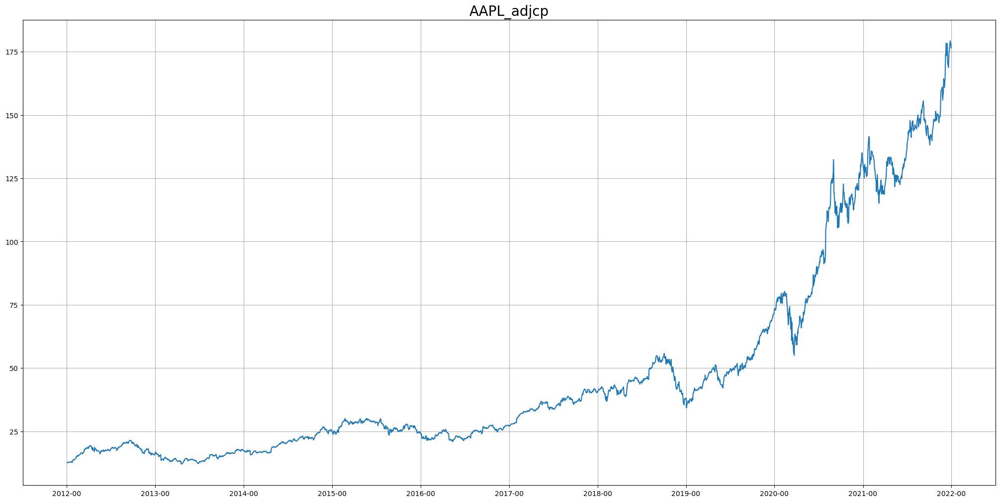

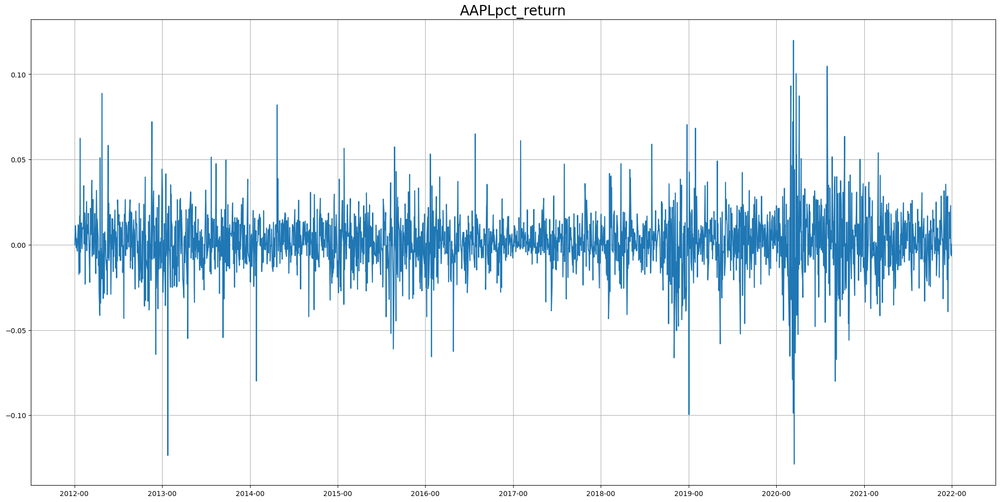

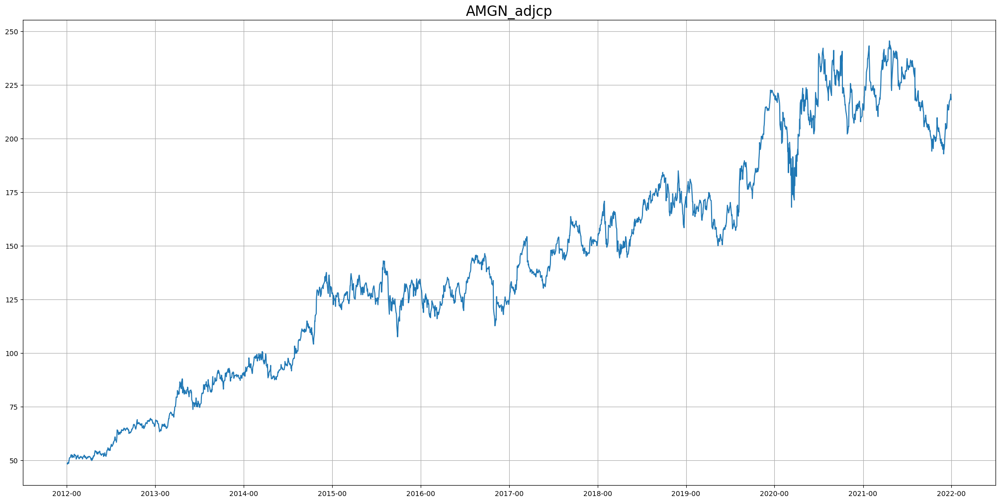

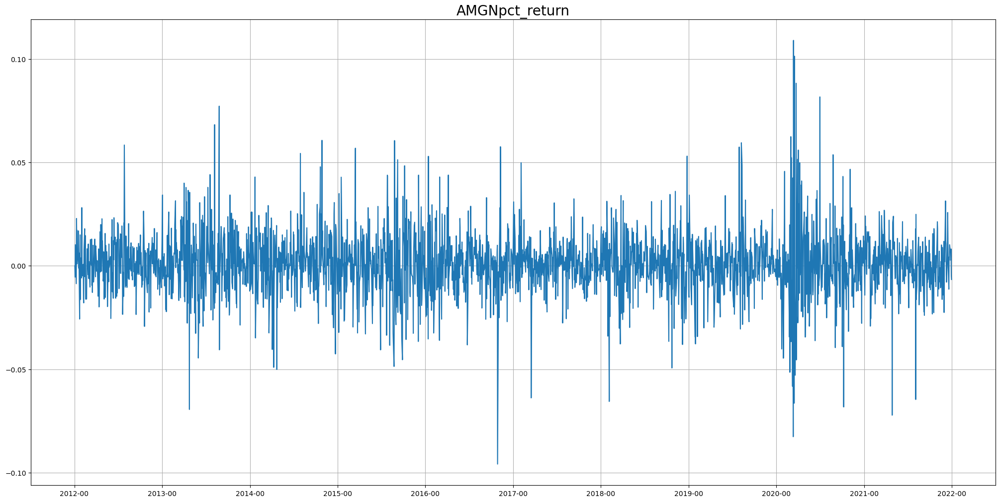

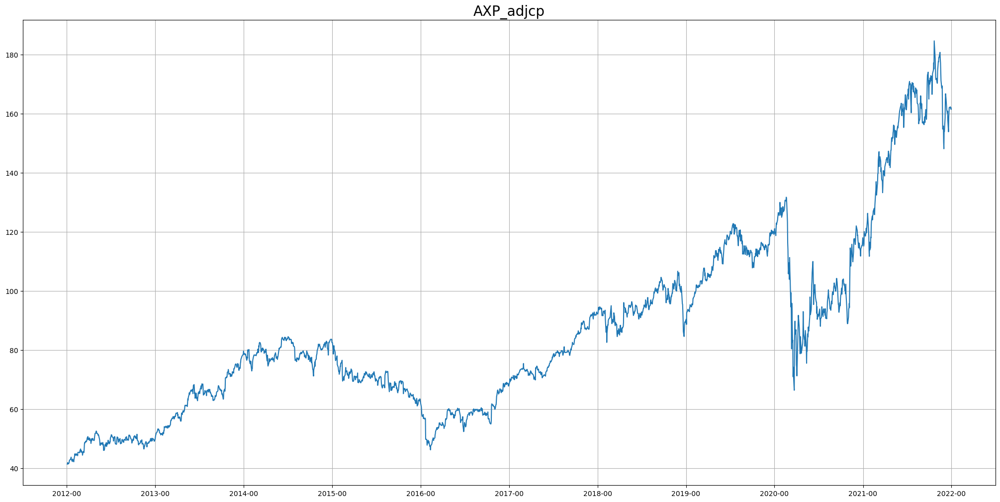

...

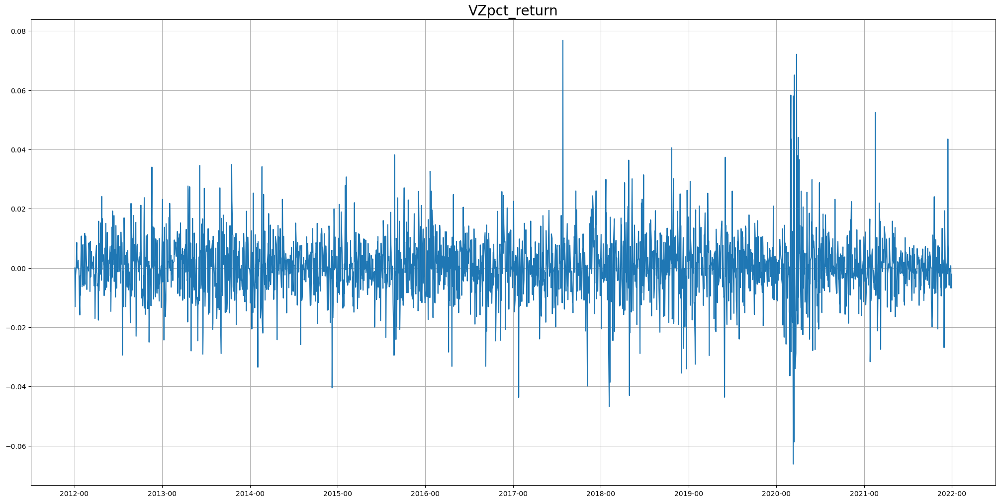

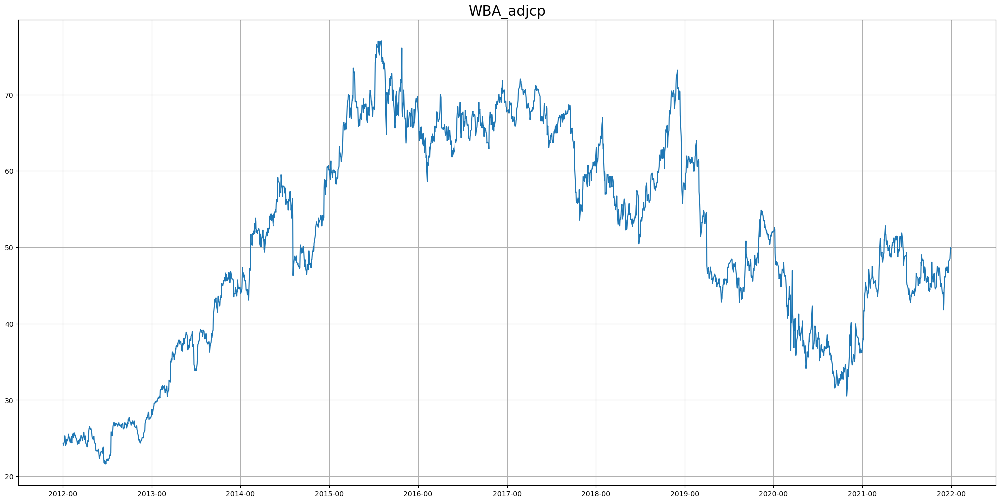

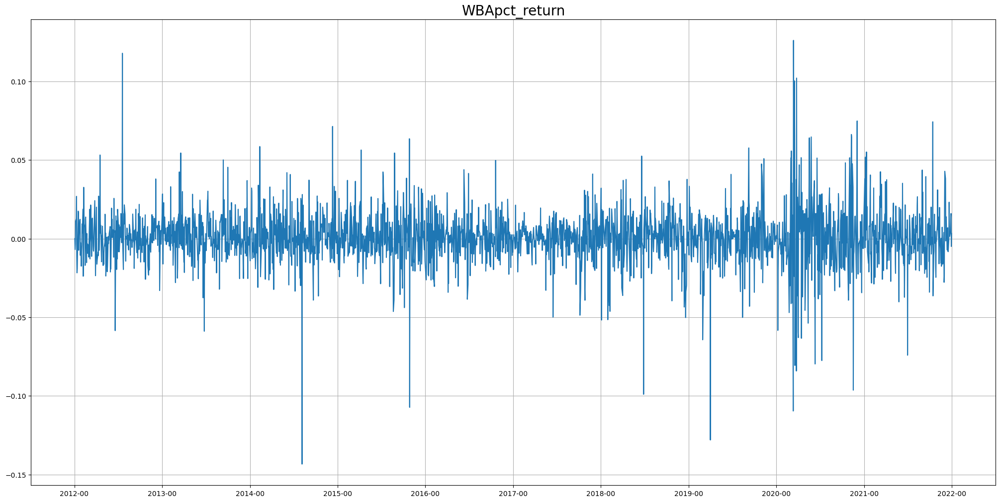

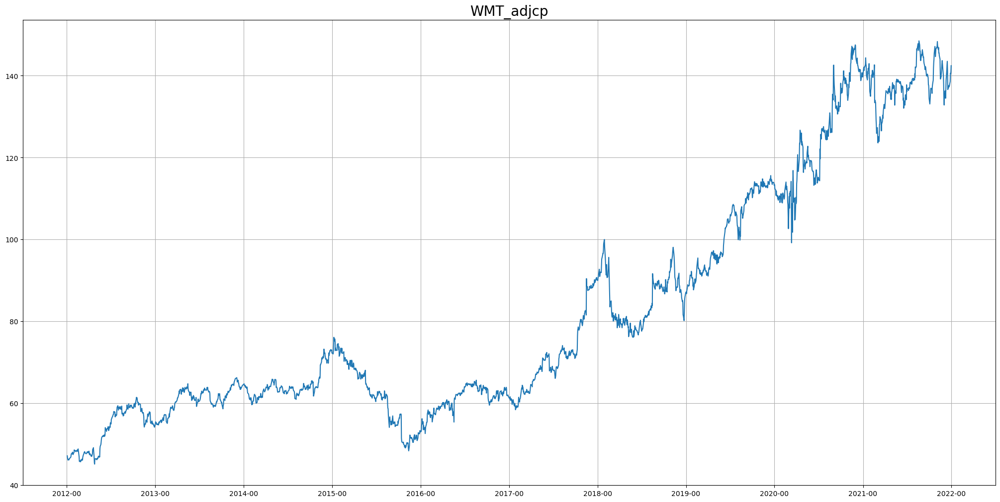

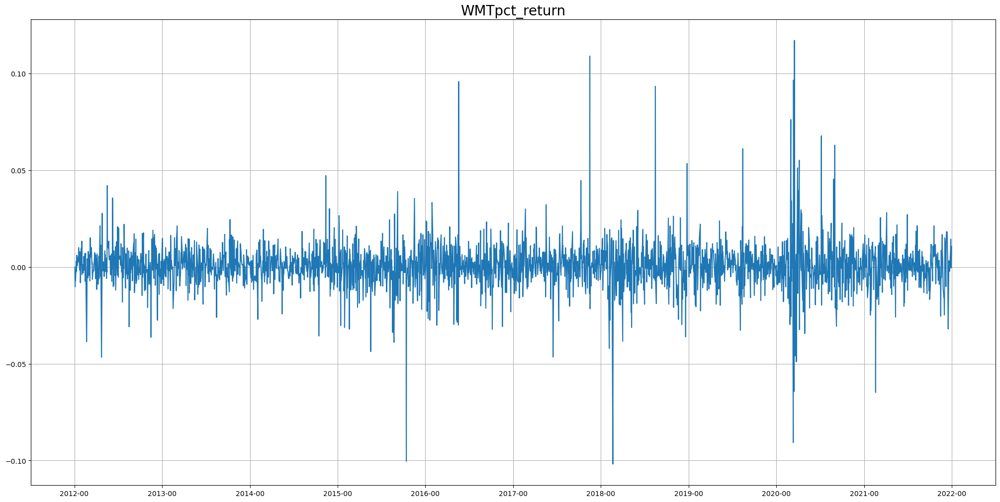

In [8]:
for i,tic in enumerate(tics):
    plot_both(data_dict[tic],tic)

# band-pass filter

In [33]:
for tic in tics:
    #It is strongly recommended to adjust the Wn based on different data. 
    #You can refer to https://en.wikipedia.org/wiki/Butterworth_filter for parameter setting 
    adjcp_apply_filter(data_dict[tic],Wn_adjcp=2/7,Wn_pct=2/14,order = 4)

/tmp/ipykernel_3565556/592085370.py:5: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots(1, 1, figsize=(20, 10),constrained_layout=True)


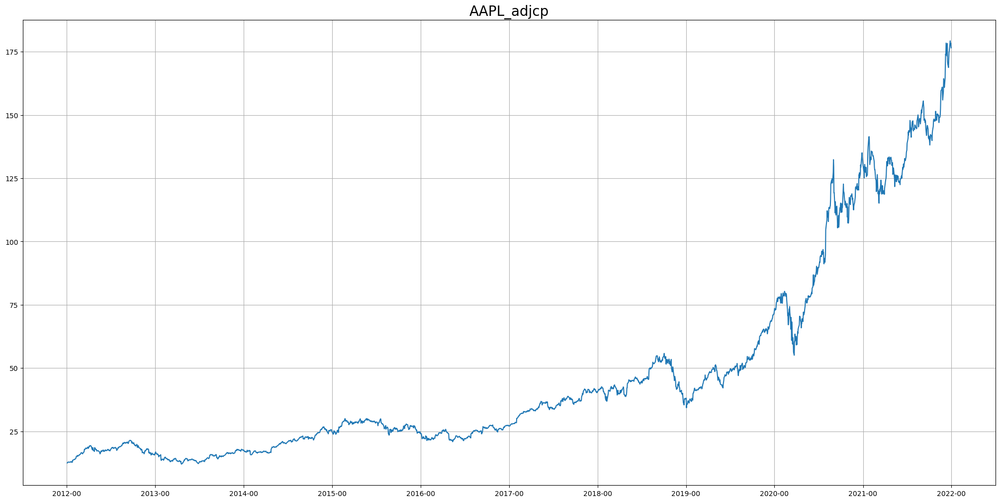

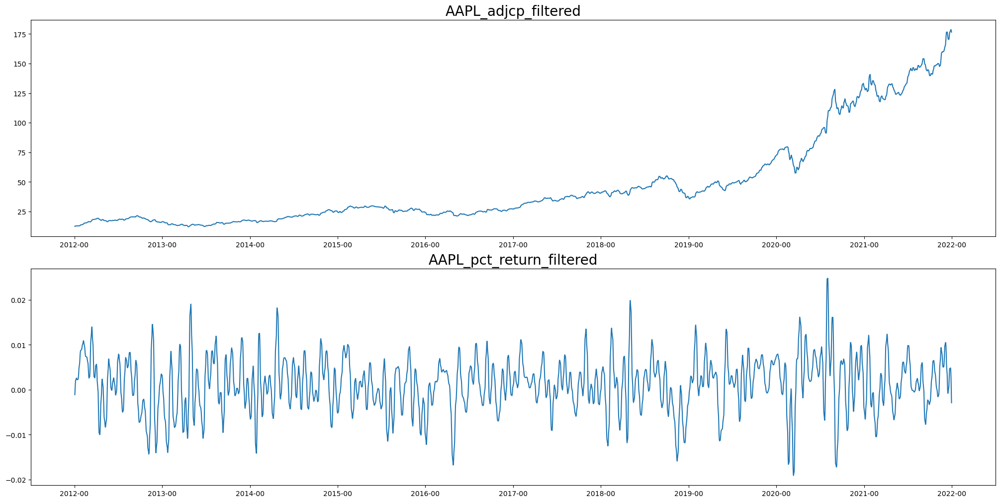

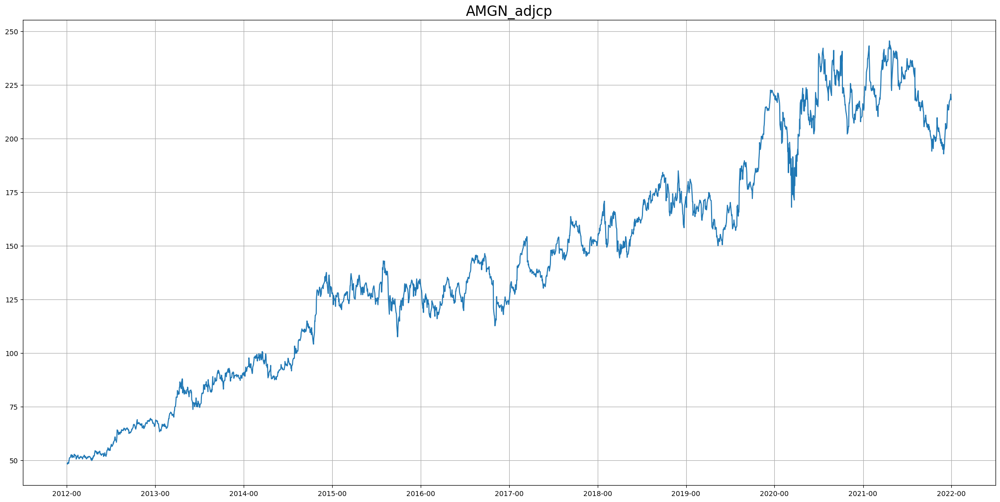

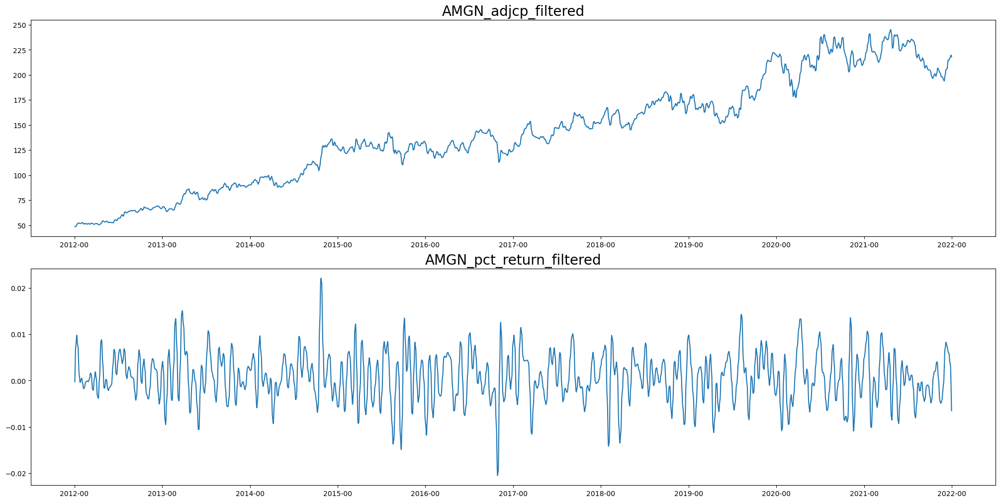

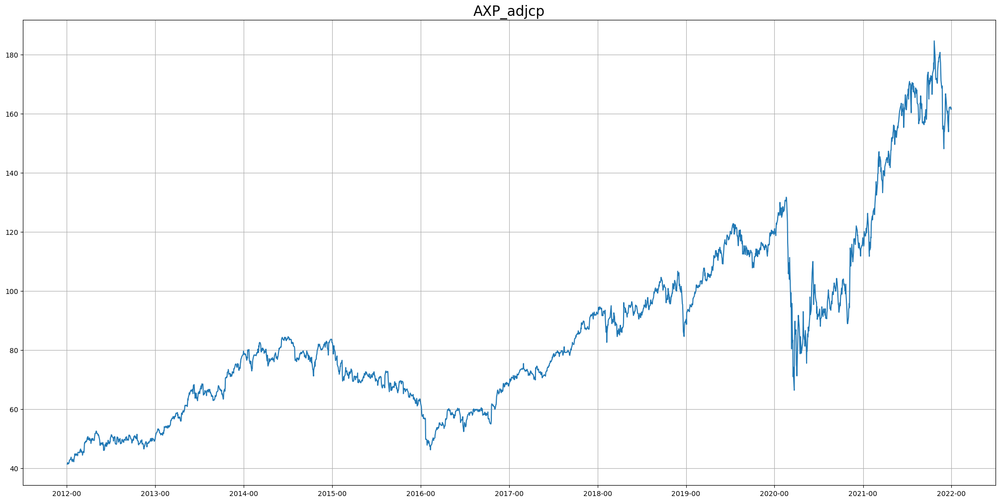

...

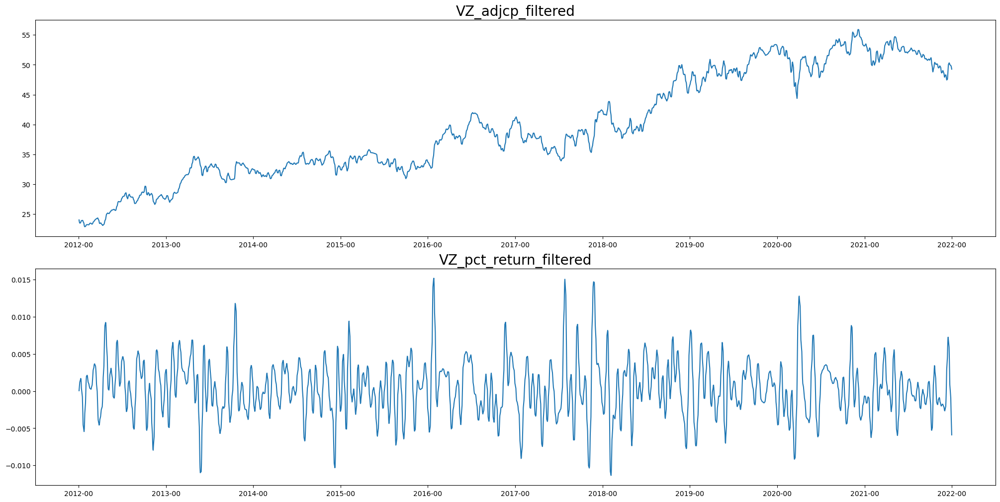

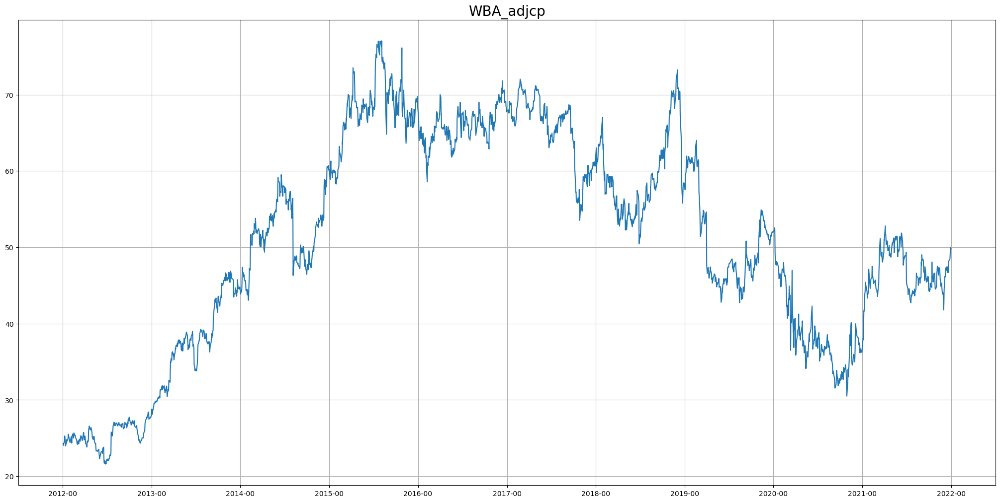

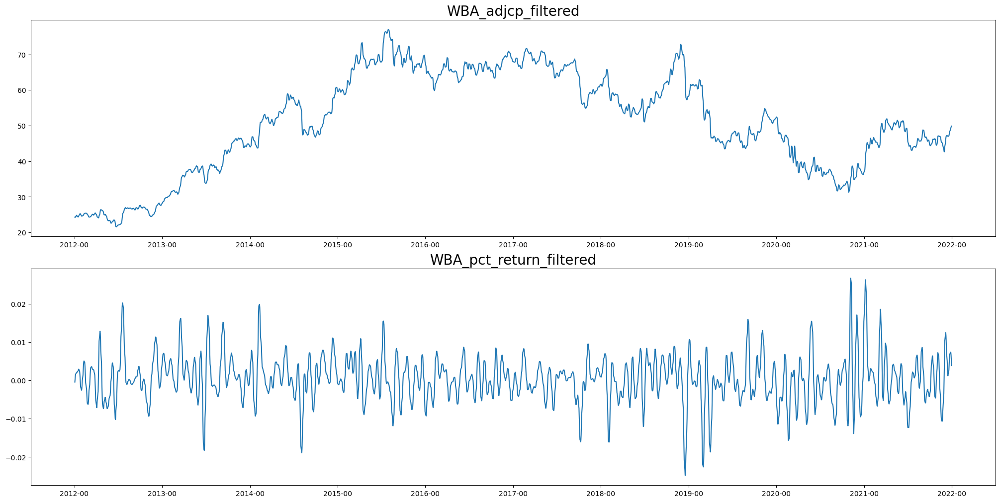

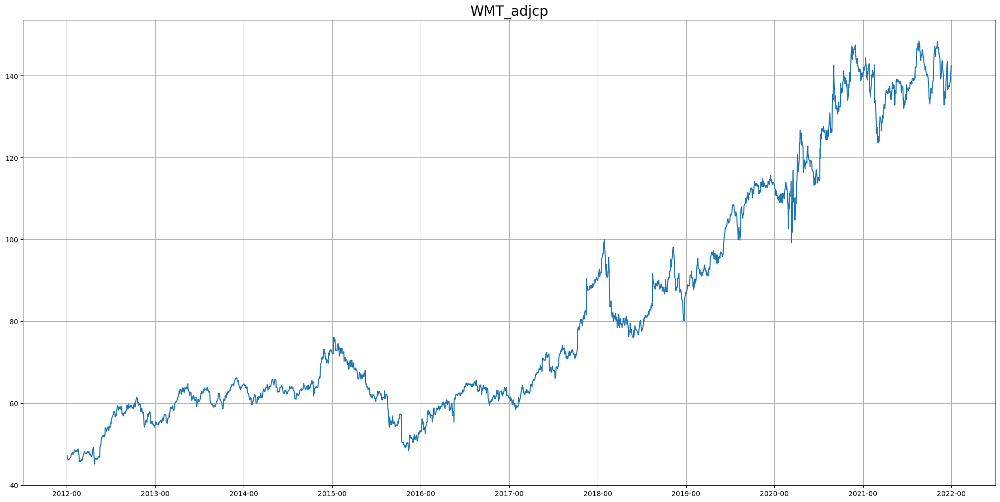

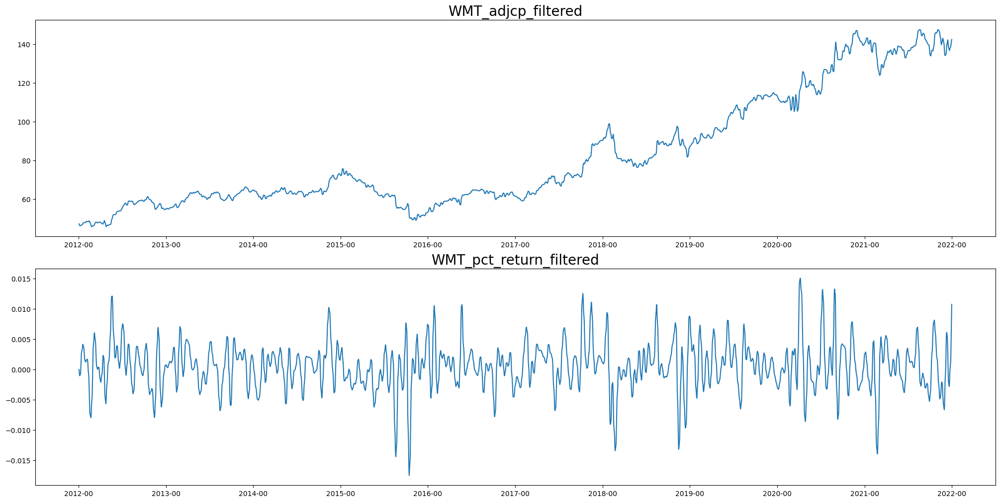

In [43]:
for tic in tics:
    #It is strongly recommended to adjust the Wn based on different data. 
    #You can refer to https://en.wikipedia.org/wiki/Butterworth_filter for parameter setting 
    adjcp_apply_filter(data_dict[tic],Wn_adjcp=2/7,Wn_pct=2/14,order = 4)
    plot_ori(data_dict[tic],tic)
    plot_by_suffix(data_dict[tic],tic,'_filtered',savefig=False)

# Min_Max normalization

In [35]:
def MinMaxScaler(data):
    numerator = data - np.min(data, 0)
    denominator = np.max(data, 0) - np.min(data, 0)
    norm_data = numerator / (denominator + 1e-7)
    return norm_data

In [41]:
for tic in tics:
    data_dict[tic]['adjcp_filtered_normalized']=MinMaxScaler(data_dict[tic]['adjcp_filtered'])
    data_dict[tic]['pct_return_filtered_normalized']=MinMaxScaler(data_dict[tic]['pct_return_filtered'])

/tmp/ipykernel_3565556/592085370.py:59: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots(2, 1, figsize=(20, 10),constrained_layout=True)


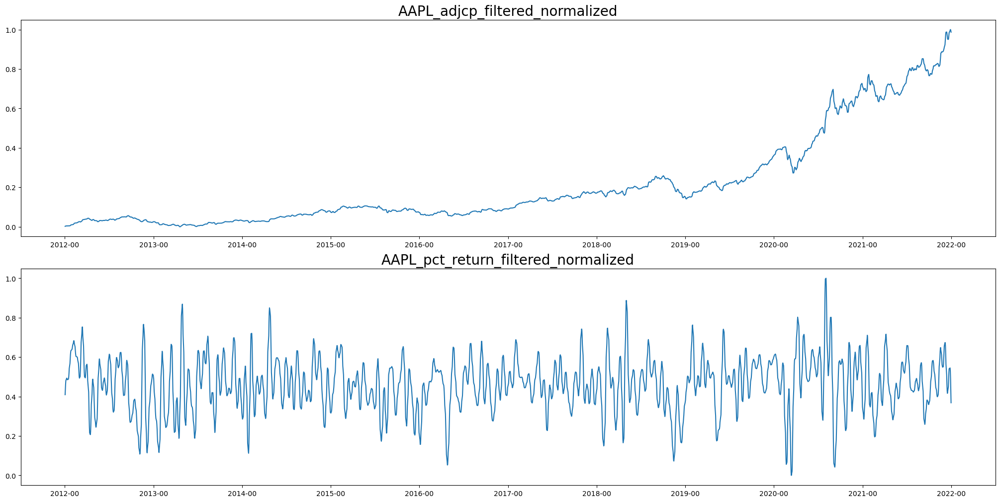

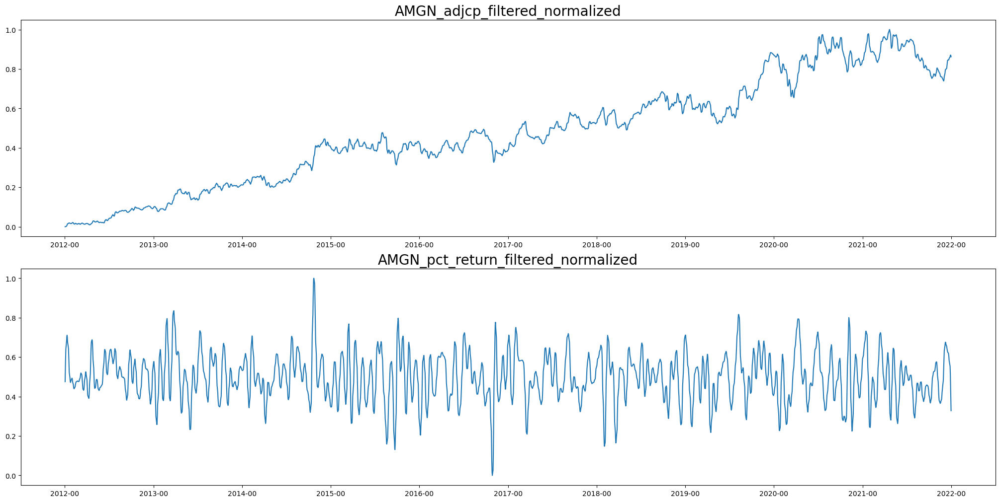

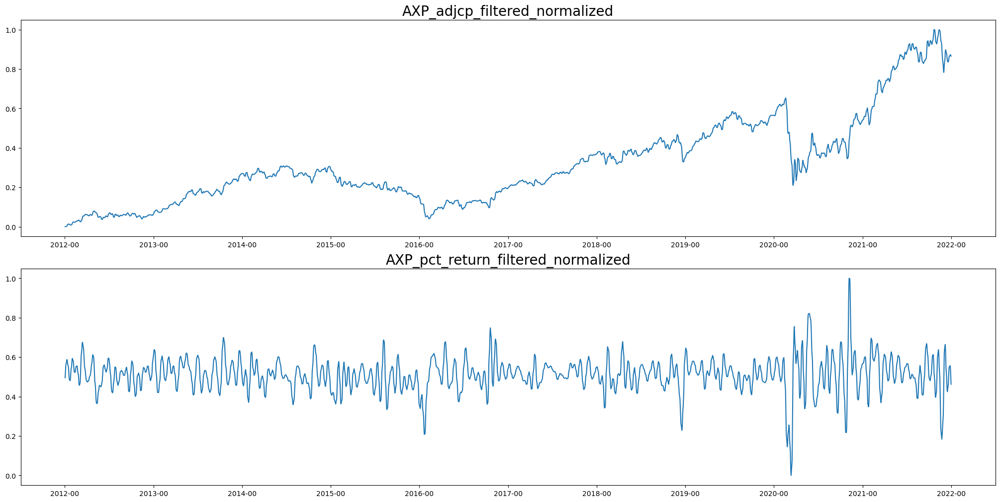

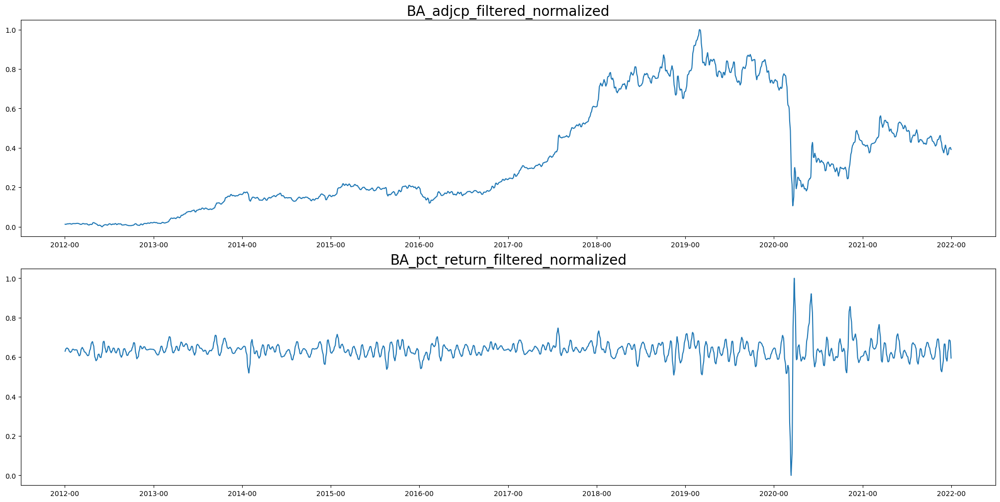

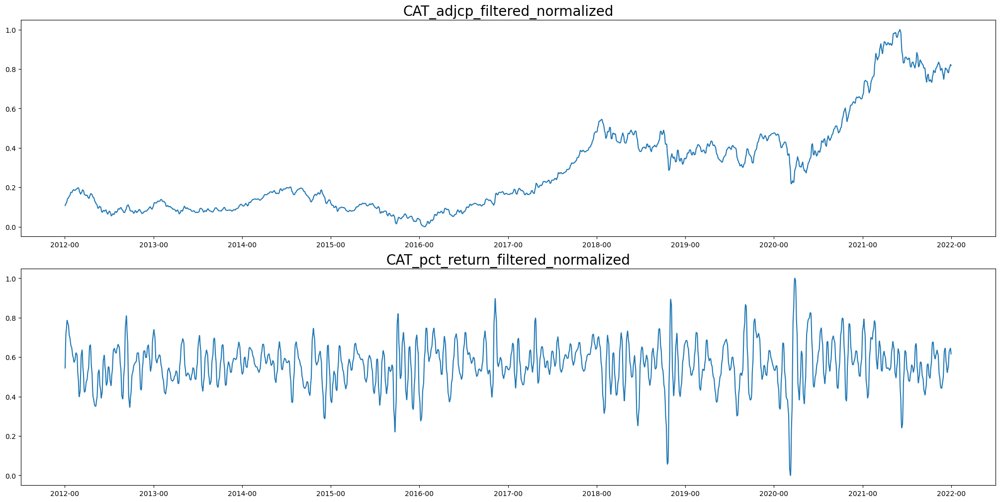

...

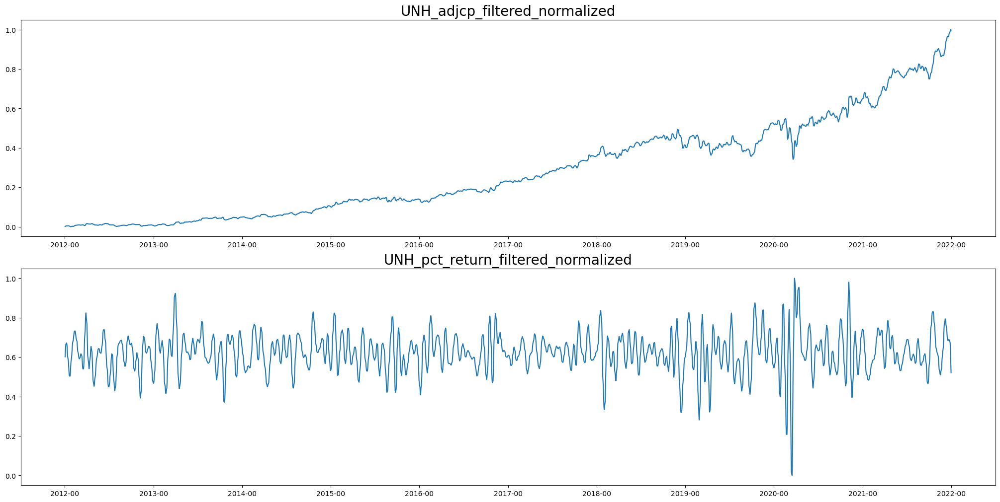

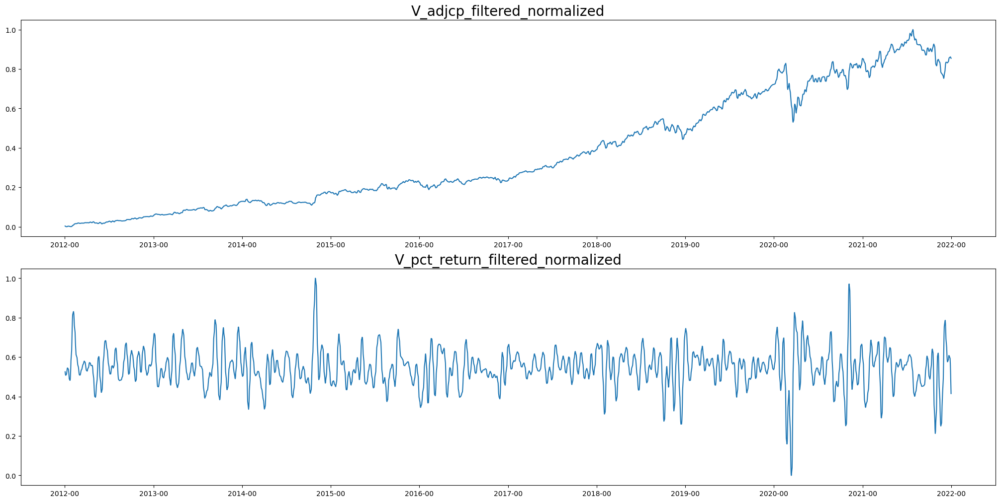

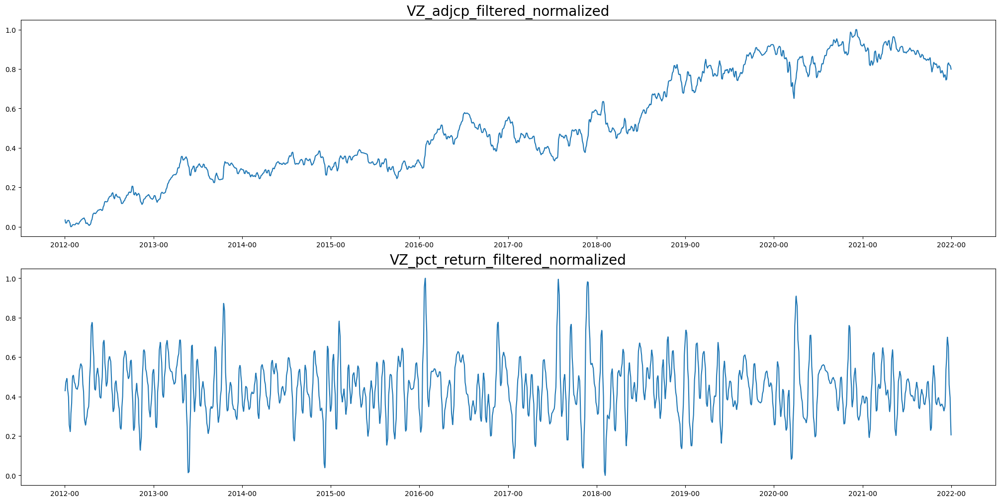

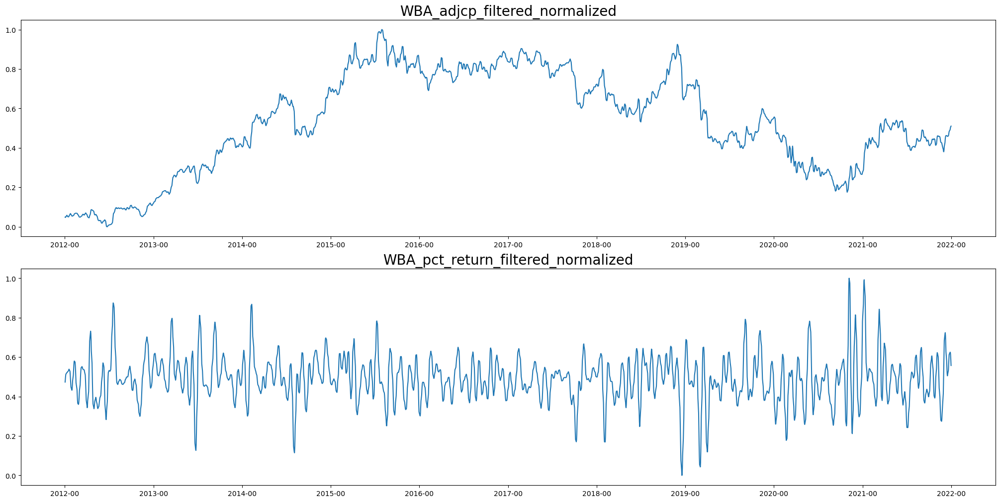

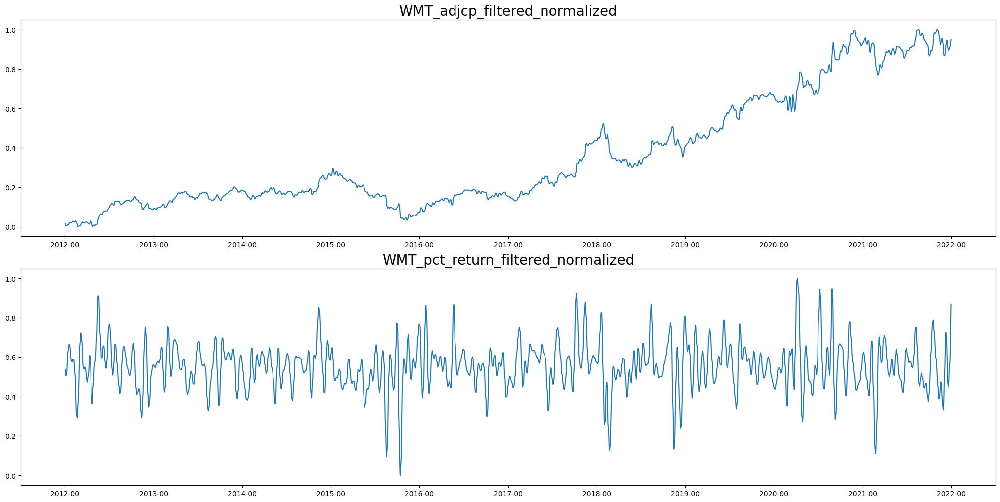

In [45]:
for tic in tics:
    plot_by_suffix(data_dict[tic],tic,'_filtered_normalized',savefig=False)

# linear model 

In [11]:
turning_points_dict={}
coef_list_dict={}
norm_coef_list_dict={}
y_pred_dict={}

In [12]:
for i,tic in enumerate(tics):
    coef_list,turning_points,y_pred_list,norm_coef_list=linear_regession_turning_points(data_ori=data_dict[tic],tic=tic)
    turning_points_dict[tic]=turning_points
    coef_list_dict[tic]=coef_list
    y_pred_dict[tic]=y_pred_list
    norm_coef_list_dict[tic]=norm_coef_list

In [46]:
all_coef_list=np.vstack([array for array in norm_coef_list_dict.values()])

In [47]:
all_coef_list.shape

(5721, 1)

In [48]:
coef_stats=pd.DataFrame(all_coef_list).describe()
display(coef_stats)
percent_25=coef_stats.loc['25%',0]
percent_75=coef_stats.loc['75%',0]

,0
count,5721.000000
mean,0.019139
std,0.571766
min,-3.152756
25%,-0.376465
50%,0.021412
75%,0.407457
max,5.085276


The low and high threshold for regime classification is adjustable.A value of -0.5 and 0.5 stand for -0.5% and 0.5% change per step.

/tmp/ipykernel_3565556/592085370.py:129: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots(2, 1, figsize=(20, 10),constrained_layout=True)


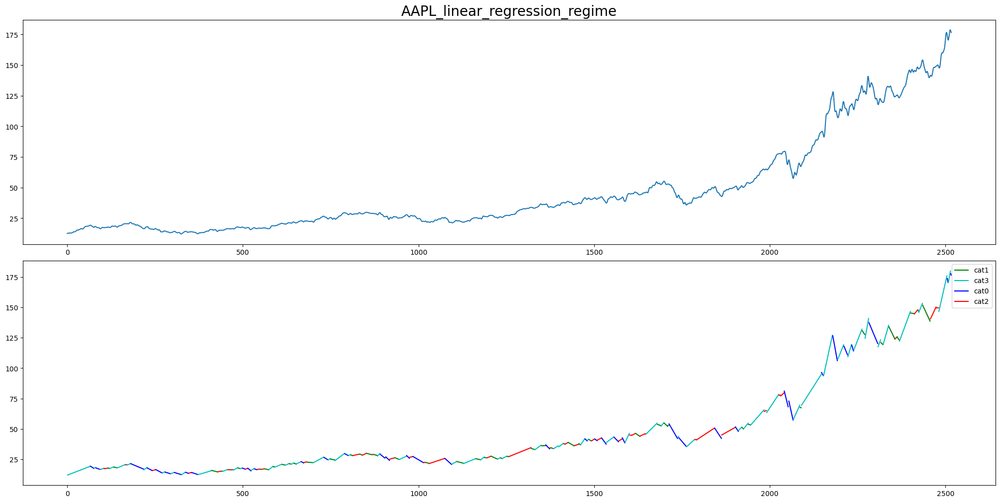

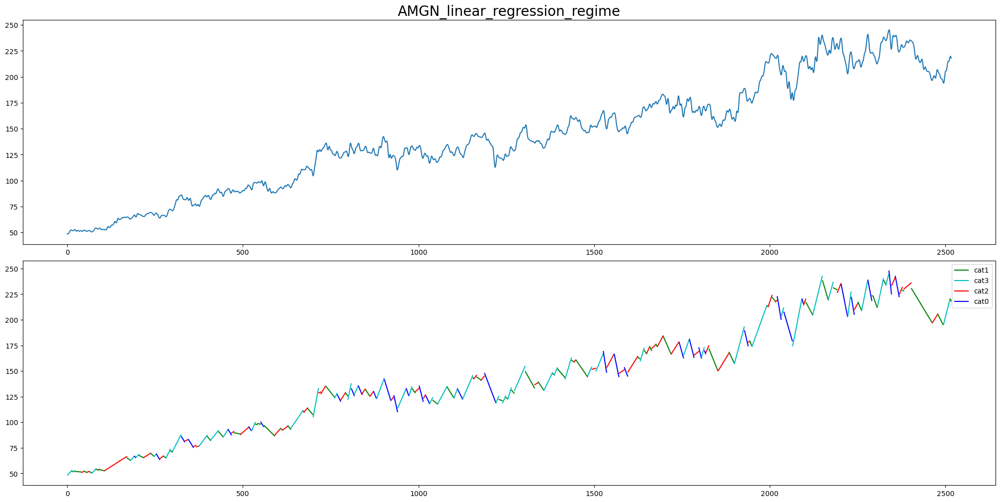

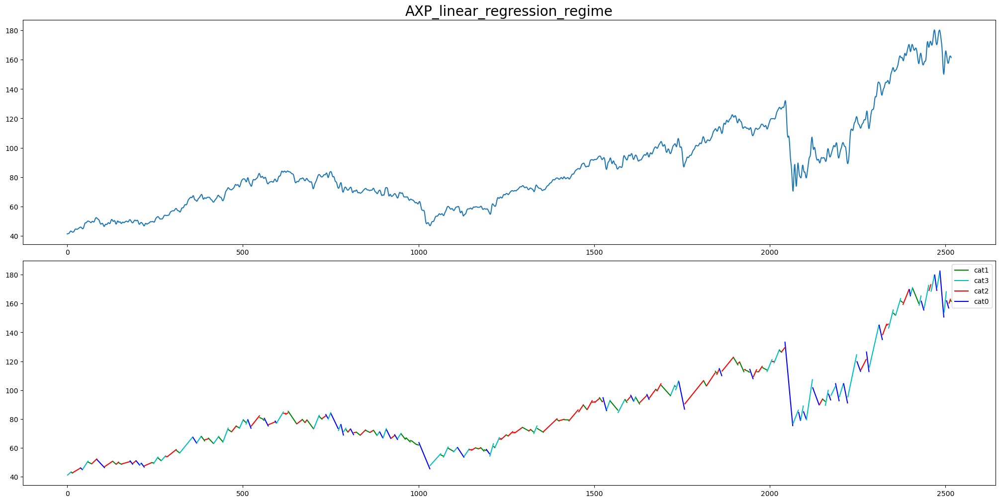

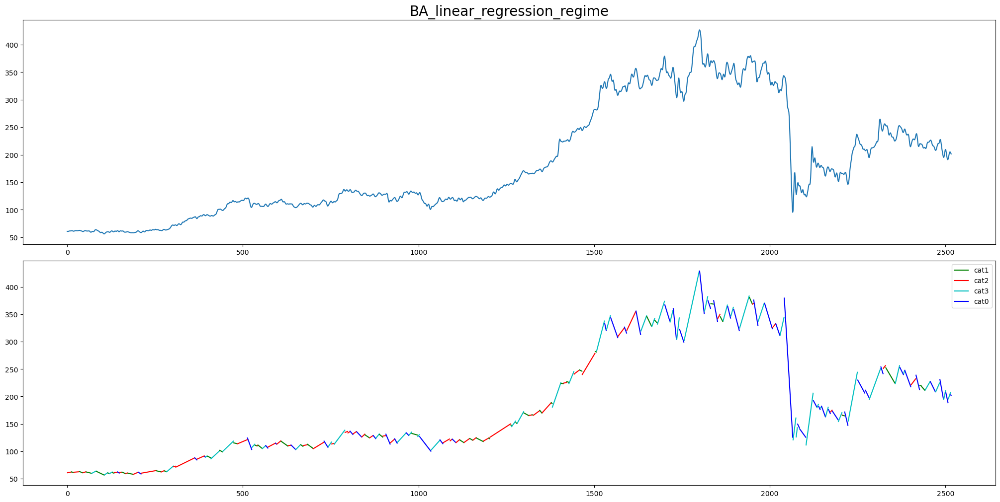

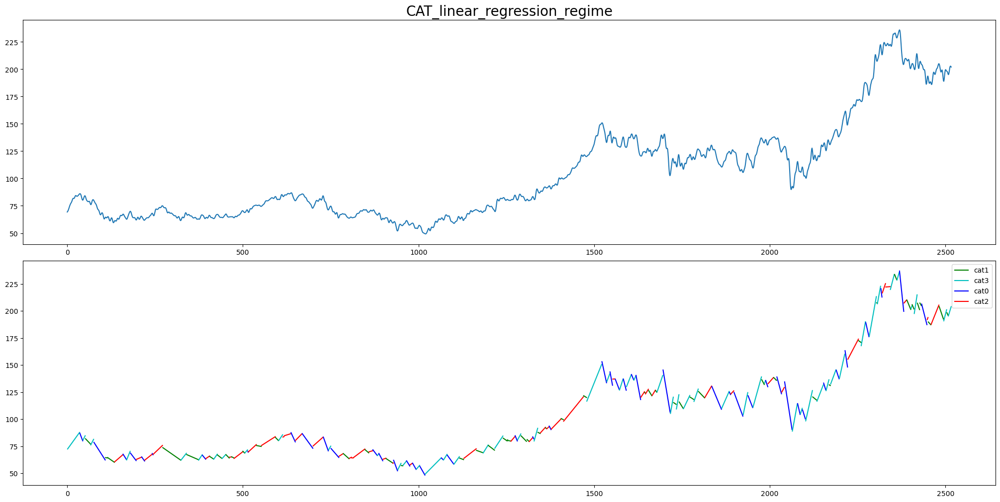

...

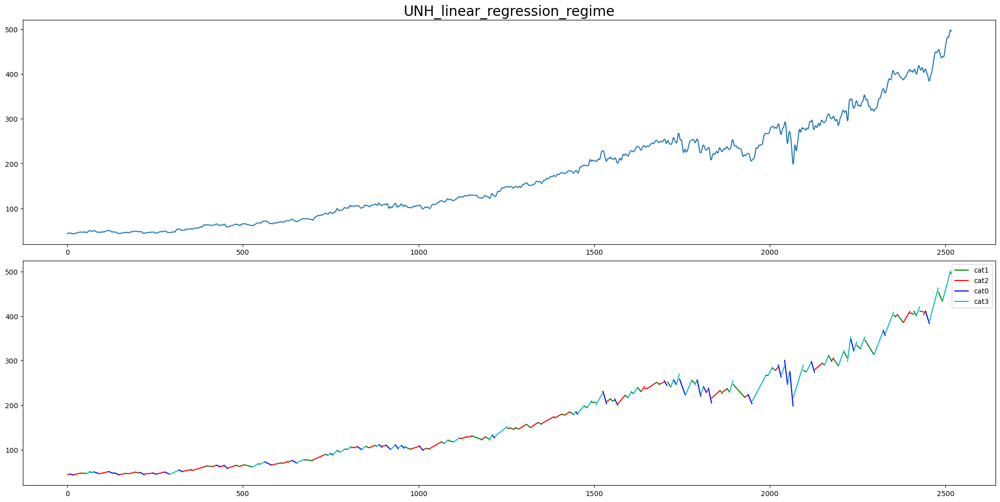

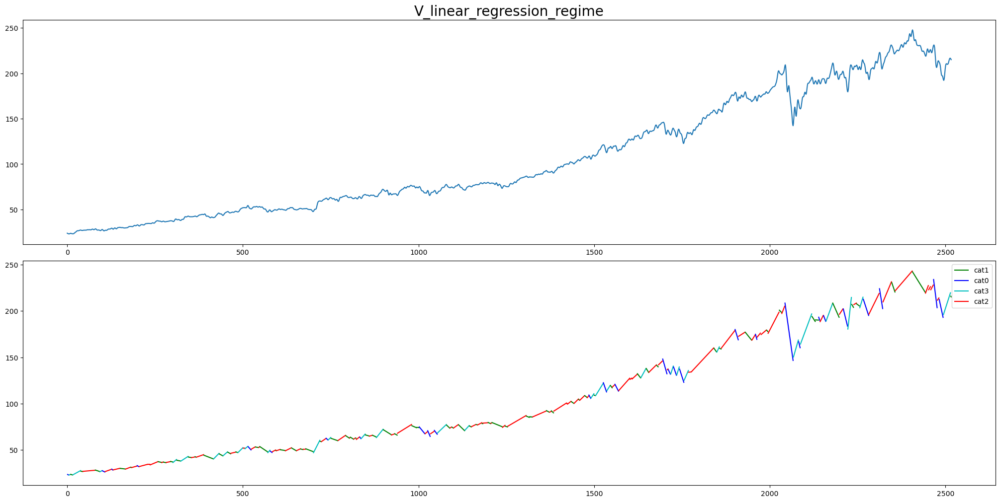

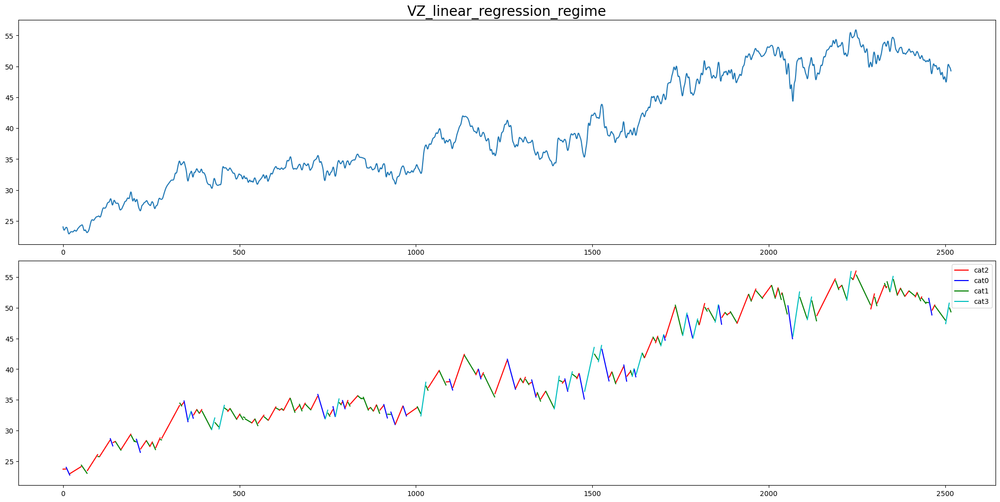

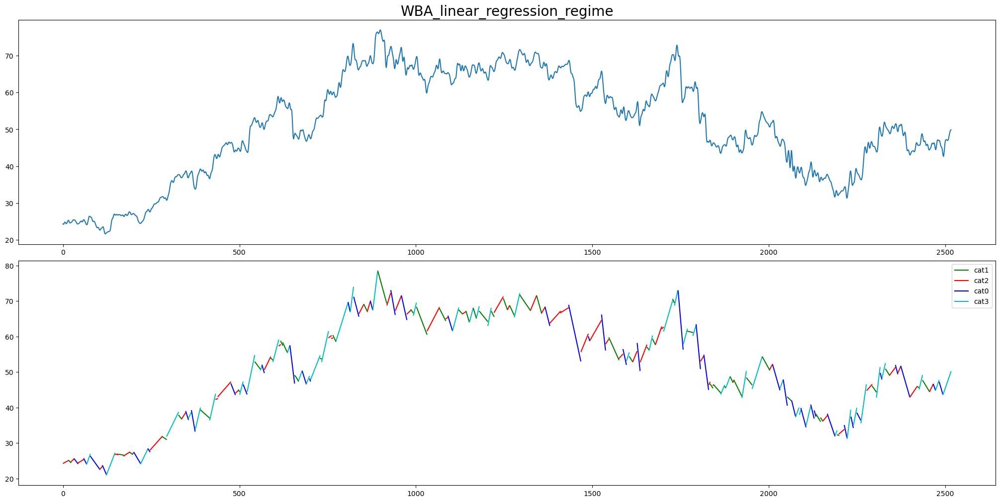

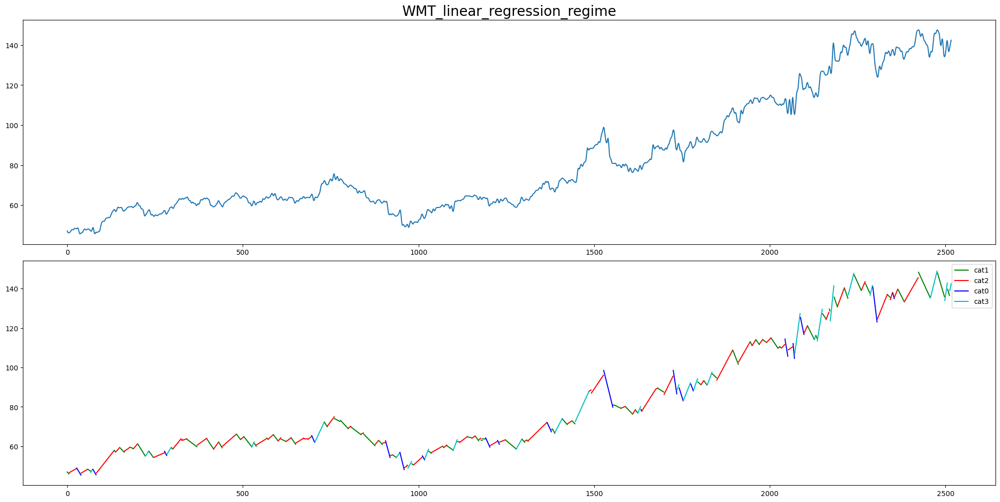

In [51]:
all_data_seg=[]
all_label_seg=[]
all_index_seg=[]
for tic in tics:
    turning_points=turning_points_dict[tic]
    coef_list=coef_list_dict[tic]
    y_pred_list=y_pred_dict[tic]
    norm_coef_list=norm_coef_list_dict[tic]
    label,data_seg,label_seg,index_seg=linear_regession_label(data_dict[tic],y_pred_list,turning_points,-0.5,0.5,norm_coef_list,'pct_return_filtered_normalized',tic)
#     display(data_seg[0])
    all_data_seg.extend(data_seg)
    all_label_seg.extend(label_seg)
    all_index_seg.extend(index_seg)
    data_dict[tic]['label']=label
    linear_regession_plot(data_dict[tic],tic,y_pred_list,turning_points,-0.5,0.5,savefig=False,normalized_coef_list=norm_coef_list)

#  Cross validation

In [20]:
def cross_validate(label,model):
    c_list=[Counter() for _ in range(4)]
    c=Counter()
    for i in range(len(all_label_seg)):
        c_list[all_label_seg[i]][label[i]]+=1
        c[label[i]]+=1
    cluster_num_counter=Counter(label)
    color_list=[None for _ in range(model.n_clusters)]
    display(c,c_list)
    for i,c in enumerate(c_list):
        l,count=c.most_common(1)[0]
        color_list[l]=i
        total=c.total()
        percent=count/total
        print('The major cluster of regime '+str(i)+' is '+str(l)+'. '+str(round(percent,2))+' of this regime is in this cluster. '
             +str(round(count/cluster_num_counter[l],2))+' of this laebl is in this regime')
    for tic in tics:
        turning_points=turning_points_dict[tic]
        coef_list=coef_list_dict[tic]
        y_pred_list=y_pred_dict[tic]
        norm_coef_list=norm_coef_list_dict[tic]
        linear_regession_plot(data_dict[tic],tic,y_pred_list,turning_points,-0.5,0.5,savefig=False,normalized_coef_list=norm_coef_list)
        validation_plot(data_dict[tic],tic,'pct_return_filtered',turning_points,False,all_index_seg,label,color_list)

In [52]:
fitting_data=to_time_series_dataset(all_data_seg)

## dwt cluster

In [ ]:
km=TimeSeriesKMeans(n_clusters=6, metric="dtw", max_iter=50,max_iter_barycenter=100,n_jobs=50,verbose=1).fit(fitting_data)

[Parallel(n_jobs=50)]: Using backend ThreadingBackend with 50 concurrent workers.
[Parallel(n_jobs=50)]: Done 100 tasks      | elapsed:    0.1s
[Parallel(n_jobs=50)]: Done 350 tasks      | elapsed:    0.3s
[Parallel(n_jobs=50)]: Done 700 tasks      | elapsed:    0.6s
[Parallel(n_jobs=50)]: Done 1150 tasks      | elapsed:    1.0s
[Parallel(n_jobs=50)]: Done 1700 tasks      | elapsed:    1.5s
[Parallel(n_jobs=50)]: Done 2350 tasks      | elapsed:    2.1s
[Parallel(n_jobs=50)]: Done 3100 tasks      | elapsed:    2.9s
[Parallel(n_jobs=50)]: Done 3950 tasks      | elapsed:    3.7s
[Parallel(n_jobs=50)]: Done 4900 tasks      | elapsed:    4.5s
[Parallel(n_jobs=50)]: Done 5663 out of 5663 | elapsed:    5.1s finished
[Parallel(n_jobs=50)]: Using backend ThreadingBackend with 50 concurrent workers.
[Parallel(n_jobs=50)]: Done 100 tasks      | elapsed:    0.1s
[Parallel(n_jobs=50)]: Done 350 tasks      | elapsed:    0.3s
[Parallel(n_jobs=50)]: Done 700 tasks      | elapsed:    0.6s
[Parallel(n_j

[Parallel(n_jobs=50)]: Done 24100 tasks      | elapsed:   26.1s
[Parallel(n_jobs=50)]: Done 26350 tasks      | elapsed:   28.6s
[Parallel(n_jobs=50)]: Done 28700 tasks      | elapsed:   31.1s
[Parallel(n_jobs=50)]: Done 31150 tasks      | elapsed:   33.9s
[Parallel(n_jobs=50)]: Done 33700 tasks      | elapsed:   36.5s
[Parallel(n_jobs=50)]: Done 33978 out of 33978 | elapsed:   36.8s finished


0.074 --> 

[Parallel(n_jobs=50)]: Using backend ThreadingBackend with 50 concurrent workers.
[Parallel(n_jobs=50)]: Done 100 tasks      | elapsed:    0.1s
[Parallel(n_jobs=50)]: Done 350 tasks      | elapsed:    0.4s
[Parallel(n_jobs=50)]: Done 700 tasks      | elapsed:    0.8s
[Parallel(n_jobs=50)]: Done 1150 tasks      | elapsed:    1.1s
[Parallel(n_jobs=50)]: Done 1700 tasks      | elapsed:    1.8s
[Parallel(n_jobs=50)]: Done 2350 tasks      | elapsed:    2.4s
[Parallel(n_jobs=50)]: Done 3100 tasks      | elapsed:    3.2s
[Parallel(n_jobs=50)]: Done 3950 tasks      | elapsed:    4.2s
[Parallel(n_jobs=50)]: Done 4900 tasks      | elapsed:    5.2s
[Parallel(n_jobs=50)]: Done 5950 tasks      | elapsed:    6.3s
[Parallel(n_jobs=50)]: Done 7100 tasks      | elapsed:    7.5s
[Parallel(n_jobs=50)]: Done 8350 tasks      | elapsed:    8.9s
[Parallel(n_jobs=50)]: Done 9700 tasks      | elapsed:   10.3s
[Parallel(n_jobs=50)]: Done 11150 tasks      | elapsed:   11.8s
[Parallel(n_jobs=50)]: Done 12700 task

0.026 --> 

In [ ]:
label=km.predict(fitting_data)

In [ ]:
import pickle
output=open('DWT.pkl','wb')
pickle.dump(km,output,-1)
output.close()
output=open('DWT.pkl','wb')
pickle.dump(labels_gak,output,-1)
output.close()

## KNN

In [21]:
from tslearn.clustering import KernelKMeans
gak_km = KernelKMeans(n_clusters=6, kernel="gak",verbose=2,n_jobs=50)
labels_gak = gak_km.fit_predict(fitting_data)

[Parallel(n_jobs=50)]: Using backend ThreadingBackend with 50 concurrent workers.
[Parallel(n_jobs=50)]: Done  62 tasks      | elapsed:    0.5s
[Parallel(n_jobs=50)]: Done 265 tasks      | elapsed:    0.8s
[Parallel(n_jobs=50)]: Done 548 tasks      | elapsed:    1.1s
[Parallel(n_jobs=50)]: Done 913 tasks      | elapsed:    1.6s
[Parallel(n_jobs=50)]: Done 1358 tasks      | elapsed:    2.0s
[Parallel(n_jobs=50)]: Done 1885 tasks      | elapsed:    2.7s
[Parallel(n_jobs=50)]: Done 2492 tasks      | elapsed:    3.5s
[Parallel(n_jobs=50)]: Done 3181 tasks      | elapsed:    4.4s
[Parallel(n_jobs=50)]: Done 3950 tasks      | elapsed:    5.5s
[Parallel(n_jobs=50)]: Done 4801 tasks      | elapsed:    6.7s
[Parallel(n_jobs=50)]: Done 5732 tasks      | elapsed:    8.3s
[Parallel(n_jobs=50)]: Done 6745 tasks      | elapsed:    9.9s
[Parallel(n_jobs=50)]: Done 7838 tasks      | elapsed:   11.4s
[Parallel(n_jobs=50)]: Done 9013 tasks      | elapsed:   13.1s
[Parallel(n_jobs=50)]: Done 10268 tasks 

[Parallel(n_jobs=50)]: Done 663452 tasks      | elapsed: 14.3min
[Parallel(n_jobs=50)]: Done 673861 tasks      | elapsed: 14.5min
[Parallel(n_jobs=50)]: Done 684350 tasks      | elapsed: 14.7min
[Parallel(n_jobs=50)]: Done 694921 tasks      | elapsed: 14.9min
[Parallel(n_jobs=50)]: Done 705572 tasks      | elapsed: 15.1min
[Parallel(n_jobs=50)]: Done 716305 tasks      | elapsed: 15.3min
[Parallel(n_jobs=50)]: Done 727118 tasks      | elapsed: 15.6min
[Parallel(n_jobs=50)]: Done 738013 tasks      | elapsed: 15.8min
[Parallel(n_jobs=50)]: Done 748988 tasks      | elapsed: 16.0min
[Parallel(n_jobs=50)]: Done 760045 tasks      | elapsed: 16.3min
[Parallel(n_jobs=50)]: Done 771182 tasks      | elapsed: 16.5min
[Parallel(n_jobs=50)]: Done 782401 tasks      | elapsed: 16.8min
[Parallel(n_jobs=50)]: Done 793700 tasks      | elapsed: 17.1min
[Parallel(n_jobs=50)]: Done 805081 tasks      | elapsed: 17.3min
[Parallel(n_jobs=50)]: Done 816542 tasks      | elapsed: 17.6min
[Parallel(n_jobs=50)]: Do

[Parallel(n_jobs=50)]: Done 2592265 tasks      | elapsed: 56.0min
[Parallel(n_jobs=50)]: Done 2612798 tasks      | elapsed: 56.5min
[Parallel(n_jobs=50)]: Done 2633413 tasks      | elapsed: 57.0min
[Parallel(n_jobs=50)]: Done 2654108 tasks      | elapsed: 57.4min
[Parallel(n_jobs=50)]: Done 2674885 tasks      | elapsed: 57.9min
[Parallel(n_jobs=50)]: Done 2695742 tasks      | elapsed: 58.4min
[Parallel(n_jobs=50)]: Done 2716681 tasks      | elapsed: 58.9min
[Parallel(n_jobs=50)]: Done 2737700 tasks      | elapsed: 59.3min
[Parallel(n_jobs=50)]: Done 2758801 tasks      | elapsed: 59.8min
[Parallel(n_jobs=50)]: Done 2779982 tasks      | elapsed: 60.3min
[Parallel(n_jobs=50)]: Done 2801245 tasks      | elapsed: 60.7min
[Parallel(n_jobs=50)]: Done 2822588 tasks      | elapsed: 61.2min
[Parallel(n_jobs=50)]: Done 2844013 tasks      | elapsed: 61.7min
[Parallel(n_jobs=50)]: Done 2865518 tasks      | elapsed: 62.2min
[Parallel(n_jobs=50)]: Done 2887105 tasks      | elapsed: 62.6min
[Parallel(

[Parallel(n_jobs=50)]: Done 5756125 tasks      | elapsed: 126.2min
[Parallel(n_jobs=50)]: Done 5786702 tasks      | elapsed: 126.9min
[Parallel(n_jobs=50)]: Done 5817361 tasks      | elapsed: 127.6min
[Parallel(n_jobs=50)]: Done 5848100 tasks      | elapsed: 128.2min
[Parallel(n_jobs=50)]: Done 5878921 tasks      | elapsed: 128.9min
[Parallel(n_jobs=50)]: Done 5909822 tasks      | elapsed: 129.6min
[Parallel(n_jobs=50)]: Done 5940805 tasks      | elapsed: 130.3min
[Parallel(n_jobs=50)]: Done 5971868 tasks      | elapsed: 131.0min
[Parallel(n_jobs=50)]: Done 6003013 tasks      | elapsed: 131.7min
[Parallel(n_jobs=50)]: Done 6034238 tasks      | elapsed: 132.4min
[Parallel(n_jobs=50)]: Done 6065545 tasks      | elapsed: 133.1min
[Parallel(n_jobs=50)]: Done 6096932 tasks      | elapsed: 133.8min
[Parallel(n_jobs=50)]: Done 6128401 tasks      | elapsed: 134.5min
[Parallel(n_jobs=50)]: Done 6159950 tasks      | elapsed: 135.2min
[Parallel(n_jobs=50)]: Done 6191581 tasks      | elapsed: 135.

[Parallel(n_jobs=50)]: Done 10124900 tasks      | elapsed: 222.5min
[Parallel(n_jobs=50)]: Done 10165441 tasks      | elapsed: 223.3min
[Parallel(n_jobs=50)]: Done 10206062 tasks      | elapsed: 224.2min
[Parallel(n_jobs=50)]: Done 10246765 tasks      | elapsed: 225.2min
[Parallel(n_jobs=50)]: Done 10287548 tasks      | elapsed: 226.1min
[Parallel(n_jobs=50)]: Done 10328413 tasks      | elapsed: 227.1min
[Parallel(n_jobs=50)]: Done 10369358 tasks      | elapsed: 228.1min
[Parallel(n_jobs=50)]: Done 10410385 tasks      | elapsed: 229.0min
[Parallel(n_jobs=50)]: Done 10451492 tasks      | elapsed: 229.9min
[Parallel(n_jobs=50)]: Done 10492681 tasks      | elapsed: 230.8min
[Parallel(n_jobs=50)]: Done 10533950 tasks      | elapsed: 231.8min
[Parallel(n_jobs=50)]: Done 10575301 tasks      | elapsed: 232.6min
[Parallel(n_jobs=50)]: Done 10616732 tasks      | elapsed: 233.6min
[Parallel(n_jobs=50)]: Done 10658245 tasks      | elapsed: 234.5min
[Parallel(n_jobs=50)]: Done 10699838 tasks      

[Parallel(n_jobs=50)]: Done 15618361 tasks      | elapsed: 344.1min
[Parallel(n_jobs=50)]: Done 15668702 tasks      | elapsed: 345.2min
[Parallel(n_jobs=50)]: Done 15719125 tasks      | elapsed: 346.3min
[Parallel(n_jobs=50)]: Done 15769628 tasks      | elapsed: 347.4min
[Parallel(n_jobs=50)]: Done 15820213 tasks      | elapsed: 348.5min
[Parallel(n_jobs=50)]: Done 15870878 tasks      | elapsed: 349.6min
[Parallel(n_jobs=50)]: Done 15921625 tasks      | elapsed: 350.7min
[Parallel(n_jobs=50)]: Done 15972452 tasks      | elapsed: 351.9min
[Parallel(n_jobs=50)]: Done 16023361 tasks      | elapsed: 353.0min
[Parallel(n_jobs=50)]: Done 16037616 out of 16037616 | elapsed: 353.3min finished


6809.356 --> 2500.094 --> 2278.767 --> 2087.179 --> 2047.988 --> 2005.700 --> 1934.861 --> 1905.607 --> 1860.630 --> 1806.884 --> 1784.510 --> 1784.510 --> 


In [22]:
import pickle
output=open('KernelKMeans.pkl','wb')
pickle.dump(gak_km,output,-1)
output.close()
output=open('KernelKMeans_labels_gak.pkl','wb')
pickle.dump(labels_gak,output,-1)
output.close()

In [23]:
display(labels_gak)

array([0, 2, 1, ..., 2, 1, 1])

Counter({5: 290, 2: 2104, 1: 1243, 0: 244, 3: 667, 4: 1115})

[Counter({2: 457, 5: 10, 4: 203, 3: 75, 1: 176, 0: 35}),
 Counter({1: 570, 2: 644, 4: 297, 0: 106, 3: 159, 5: 34}),
 Counter({0: 85, 2: 596, 1: 386, 4: 312, 5: 187, 3: 286}),
 Counter({5: 59, 1: 111, 2: 407, 3: 147, 4: 303, 0: 18})]

The major cluster of regime 0 is 2. 0.48 of this regime is in this cluster. 0.22 of this laebl is in this regime
The major cluster of regime 1 is 2. 0.36 of this regime is in this cluster. 0.31 of this laebl is in this regime
The major cluster of regime 2 is 2. 0.32 of this regime is in this cluster. 0.28 of this laebl is in this regime
The major cluster of regime 3 is 2. 0.39 of this regime is in this cluster. 0.19 of this laebl is in this regime


/tmp/ipykernel_3565556/1476464621.py:129: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots(2, 1, figsize=(20, 10),constrained_layout=True)


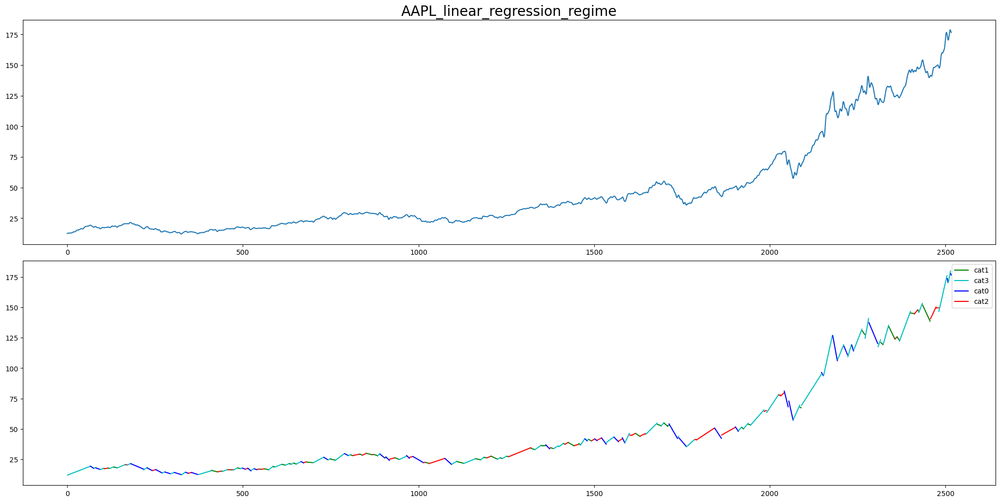

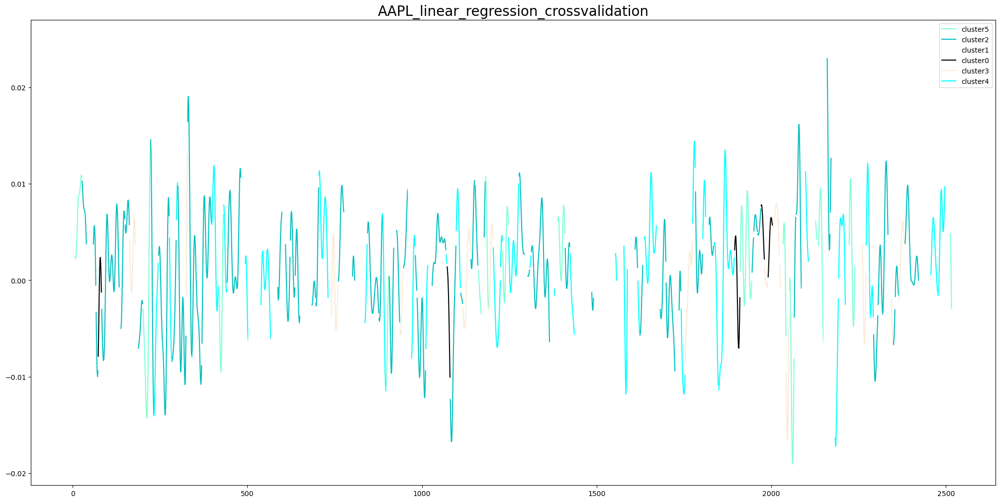

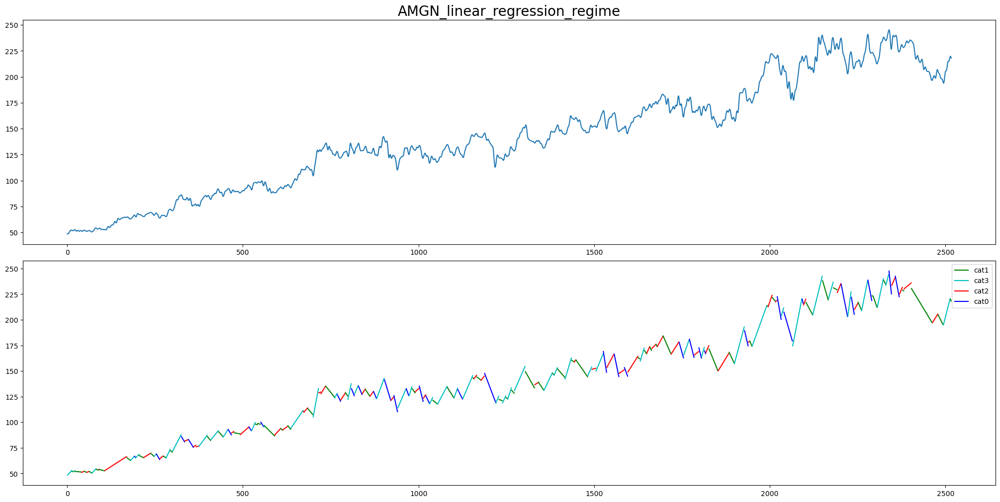

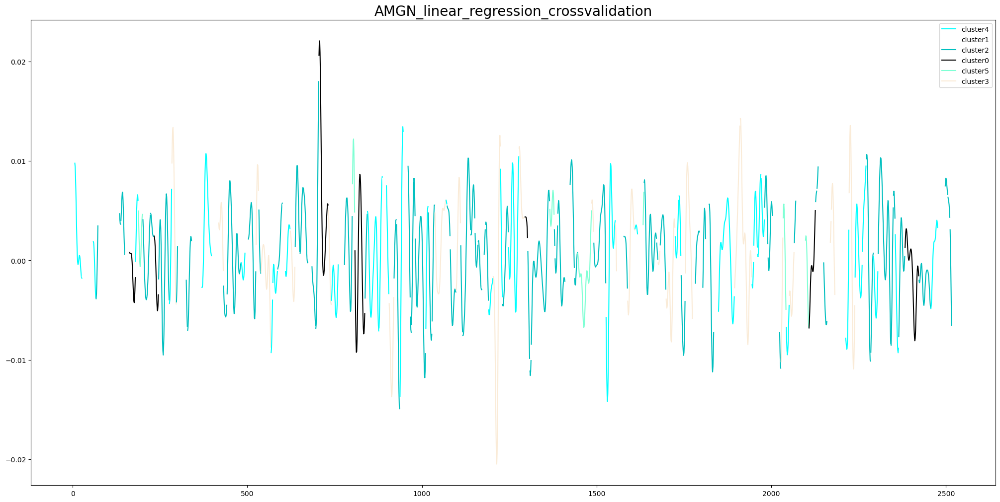

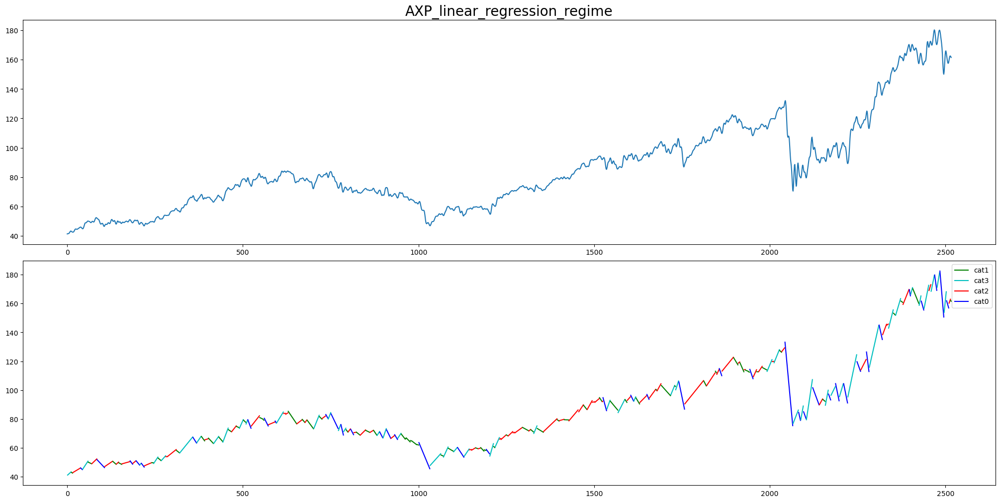

...

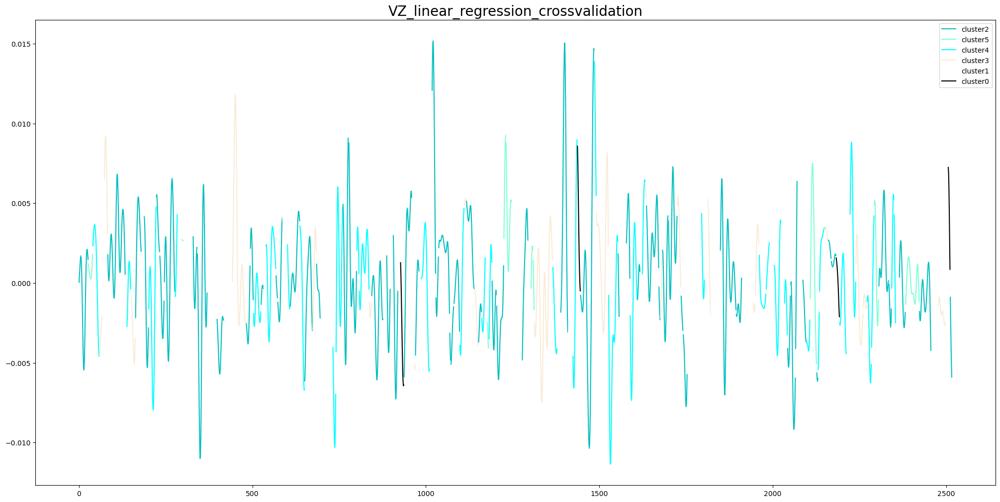

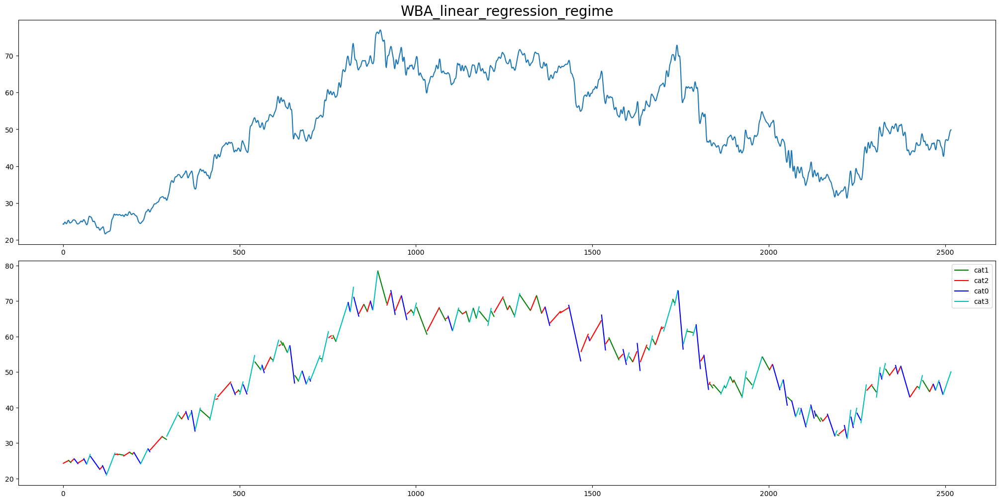

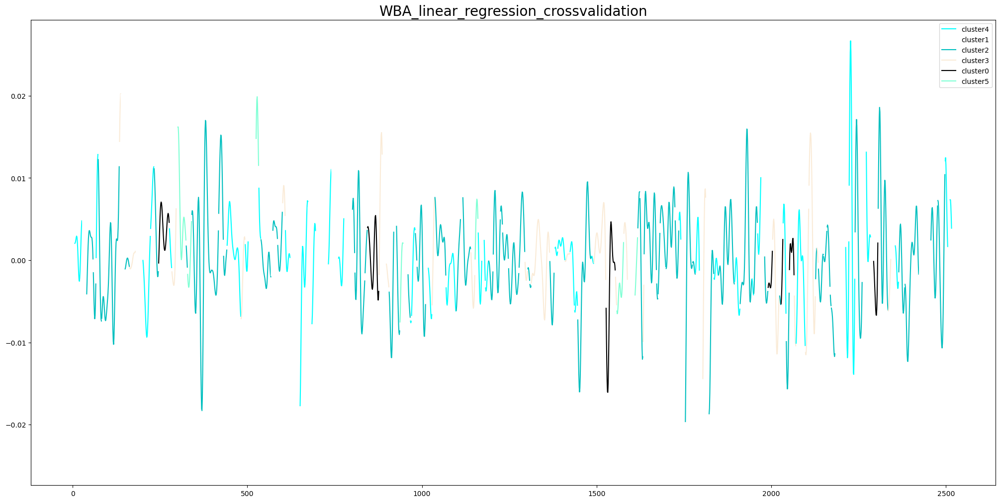

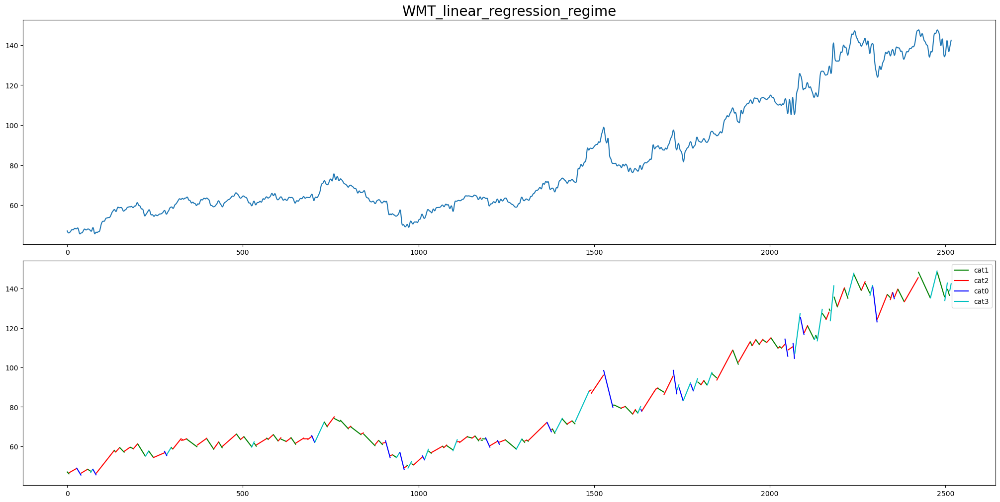

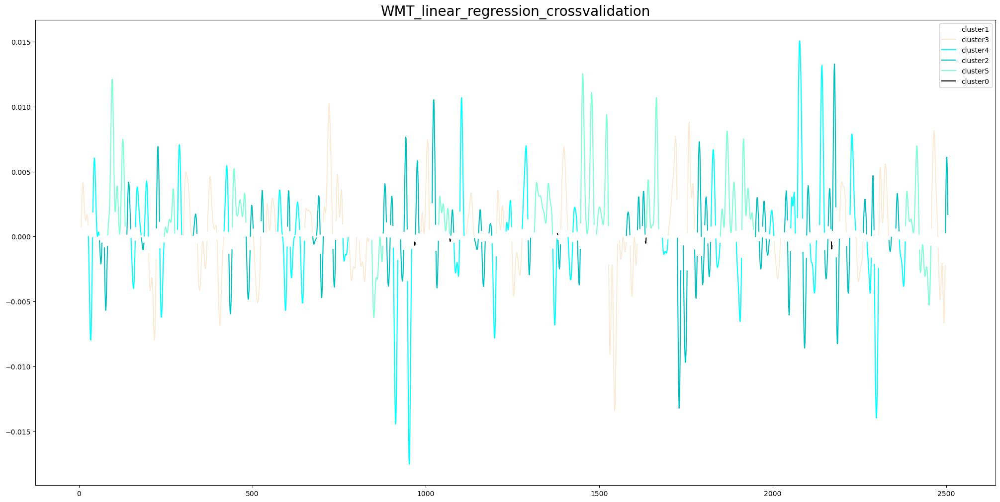

In [23]:
cross_validate(labels_gak,gak_km)

## Shapelets

In [ ]:

clf = LearningShapelets(n_shapelets_per_size={3: 1})
clf.fit(X, y)